In [23]:
import numpy as np
from tqdm.notebook import tqdm
import pandas as pd
import geopandas as gpd 
import collections
import mapclassify as mc
import json
import folium
import re
import plotly.express as px
import plotly.graph_objects as go
import geopy
from geopy.geocoders import Nominatim
from datetime import datetime
from datetime import date
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import silhouette_score
from tqdm.notebook import tqdm
import nltk
from nltk.tokenize import word_tokenize
from pprint import pprint
import ast
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import os
from nltk.tokenize import RegexpTokenizer
from nltk.tokenize import word_tokenize
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import re
import string
from Bio import Entrez
import pycountry
pd.set_option('display.max_rows', 180)
pd.options.mode.chained_assignment = None 

In [24]:

def load_data(path_food_dis, path_mental_ill):
    food_dis = pd.read_csv(path_food_dis, sep='\t', dtype=str)
    mental_ill = pd.read_csv(path_mental_ill, sep='\t', dtype=str)
    food_dis = food_dis.query("sciname != 'bacterium'")
    mental_ill = mental_ill.query("sciname != 'bacterium'")
    food_dis = food_dis[~food_dis["sciname"].str.contains("uncultured")]
    mental_ill = mental_ill[~mental_ill["sciname"].str.contains("uncultured")]
    food_dis['sciname'] = food_dis['sciname'].apply(lambda x: re.sub('[\[|\]]', '', x))
    mental_ill['sciname'] = mental_ill['sciname'].apply(lambda x: re.sub('[\[|\]]', '', x))
    
    #top 10 food illness
    sciname_f = food_dis.groupby('sciname').count()[['accession']].index
    count_f = food_dis.groupby('sciname').count()['accession'].values
    dict_sciname_f = {'sciname':sciname_f, 'accession':count_f}
    top_food_ill = pd.DataFrame(dict_sciname_f, columns = ['sciname','accession'])
    top_food_ill = top_food_ill.sort_values(by='accession', ascending=False).head(10)
    top_food_ill = top_food_ill.sort_values(by='accession')
    
    #top 10 mental illness
    sciname_i = mental_ill.groupby('sciname').count()[['accession']].index
    count_i = mental_ill.groupby('sciname').count()['accession'].values
    dict_sciname_i = {'sciname':sciname_i, 'accession':count_i}
    top_mental_ill = pd.DataFrame(dict_sciname_i, columns = ['sciname','accession'])
    top_mental_ill = top_mental_ill.sort_values(by='accession', ascending=False).head(10)
    top_mental_ill = top_mental_ill.sort_values(by='accession')
    
    #organism unique
    food_dis_sciname = set(food_dis['sciname'].values)
    mental_ill_sciname = set(mental_ill['sciname'].values)
    
    #operazioni insiemistiche
    intersection_organism = mental_ill_sciname.intersection(food_dis_sciname)
    organism_only_ill = mental_ill_sciname - food_dis_sciname
    organism_only_fd = food_dis_sciname - mental_ill_sciname
    
    return top_food_ill, top_mental_ill, intersection_organism, organism_only_ill, organism_only_fd

In [25]:
path_food_dis = "./data/final_blast_top_sequences_food_disorders.tsv"
path_mental_ill = "./data/final_blast_top_sequences_mental_illness.tsv"
top_food_ill, top_mental_ill , _, _, _ = load_data(path_food_dis, path_mental_ill)

In [26]:
#inizio ad analizzare un organismo di quelli in comune Bacteroides vulgatus compare 4 volte in disordini alimentari e 6 
#volte in malattie mentali  (il primo in comune nella top ten)

In [27]:
Entrez.email = "r.matamorosaragon@campus.unimib.it"

In [28]:
file = open('./data/stop_words_list.txt',mode='r')
 
# read all lines at once
list_stop_words = file.read()
 
# close the file
file.close()
list_stop_words = ast.literal_eval(list_stop_words)

def esearch(db, query, num_max = 20):
    handle = Entrez.esearch(db = db, term = query, retmax = num_max)
    record = Entrez.read(handle, validate = True)
    return record

def esummary(db, id_val):
    handle = Entrez.esummary(db = db, id = id_val)
    record = Entrez.read(handle, validate = True)
    return record

def efetch(db, id_val, retmode = 'xml'):
    handle = Entrez.efetch(db  = db, id = id_val, retmode = retmode)
    record = Entrez.read(handle, validate = True)
    return record

def get_idList(record):
    return record['IdList']

def retrieve(ids, db, organism):
    sums = list()
    fets = list()
    for id_val in tqdm(ids, desc="Papers processed"):
        sums.append(esummary(db, id_val))
        fets.append(efetch(db, id_val))
    
    try:
        os.mkdir('data', 0o755)
    except OSError:
        pass
    #os.mkdir('data')
    with open('./data/'+organism+'_summaries.txt', 'w') as filehandle:
        json.dump(sums, filehandle)
    with open('./data/'+organism+'_fetchs.txt', 'w') as filehandle:
        json.dump(fets, filehandle)
    
    return sums, fets

def get_data(ids, db, organism):   
    try:
        with open('./data/'+organism+'_summaries.txt', 'r') as filehandle:
            sums = json.load(filehandle)
        with open('./data/'+organism+'_fetchs.txt', 'r') as filehandle:
            fets = json.load(filehandle)  
        return sums, fets
    except:
        return retrieve(ids, db, organism)

In [29]:
def plot_num_per_date(summaries, organism, destination_path):
    years_and_value = dict()
    year = ''
    for summary in summaries:
        #print(summary[0])
        year = summary[0]['PubDate'].split()[0]
        if year in years_and_value:
            years_and_value[year] += 1
        else:
            years_and_value[year] = 1

    years_and_value = dict(sorted(years_and_value.items()))

    years = list(years_and_value.keys())
    values = list(years_and_value.values())
    mean = sum(values)/len(values)
    plot_line(years, values, 'Number of papers about '+organism+' for year', 'Year', '# Paper', organism+' paper', mean, destination_path)

# https://www.efsa.europa.eu/it/press/news/biohaz100414
def plot_line(x_values, y_values, title, x_text, y_text, legend, mean, destination_path):
    
    x_values = pd.Series(data=x_values)
    y_values = pd.Series(data=y_values)
    
    fig, ax = plt.subplots(figsize=(15, 10))
    fig.set_size_inches(22,8)
    ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    ax.plot(x_values, y_values, color='black', marker='o', label = legend)
    if mean > 0:
        ax.axhline(y=mean, color='red', label = 'Average number of publications', linestyle='-')
        mean_line = pd.Series(data=[mean]*len(x_values))
        ax.fill_between(x_values, y_values, mean_line,
                         where=(y_values > mean_line),
                         interpolate=True, color='blue', alpha=0.25, label='Above Avg')

        ax.fill_between(x_values, y_values, mean_line,
                         where=(y_values <= mean_line),
                         interpolate=True, color='red', alpha=0.25, label='Below Avg')
    ax.legend()
    ax.set_title(title)
    ax.set_xlabel(x_text)
    ax.set_ylabel(y_text)
    save_img(title, destination_path)
    
    
    plt.show()
    
def plot_hbar(y_values, x_values, title, x_text, y_text,destination_path):   
    #plot
    fig=go.Figure([go.Bar(x=x_values, y=y_values,
                          text=x_values,
                          textposition='auto',orientation='h')])
    
    #customize aspect
    fig.update_traces(overwrite=True,
                    marker={"color": x_values,
                            "colorscale": 'blugrn'},
                                 )

    fig.update_layout(title={'text':title,
                                    'y':0.95,
                                    'x':0.5,
                                    'xanchor': 'center',
                                    'yanchor': 'top'},
                                    autosize=False,
                                    width=900,
                                    height=950,
                                  #titlefont=,
                                  #xaxis_title="x Axis Title",
                                  yaxis_title=y_text,
                                  font=dict(family="Bodoni 72 Smallcaps",
                                            size=17,
                                            color='black'),
                                  paper_bgcolor='#ffffff',
                                  plot_bgcolor='#e6f0f5',
                                  bargap=0.4
                                 )
    fig.write_html(destination_path+"top_authors.html")
    
    fig.show()

    
def plot_lang(fetchs, years):
                
    lang_and_value = dict()
    lang = ''
    cont = 0
    for fetch in fetchs:
        lang = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['Language'][0]
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                return -1
            if int(summaries[cont][0]['PubDate'].split()[0]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0]) <= years[1]:
                if lang in lang_and_value:
                    lang_and_value[lang] += 1
                else:
                    lang_and_value[lang] = 1
        else:
            if lang in lang_and_value:
                lang_and_value[lang] += 1
            else:
                lang_and_value[lang] = 1
        cont += 1
            


    langs = list(lang_and_value.keys())
    values = list(lang_and_value.values())
    
    if years != []:
        title = 'Language used for Anisakis Simplex papers from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Language used for Anisakis Simplex papers ever'
    plot_hbar(langs, values, title, '# Paper', 'Language')
    
    
def word_cloud(words):
    words = words.lower()
    words = re.sub(r'\d+', '', words)
    words = words.translate(str.maketrans('', '', string.punctuation))
    tokenizer = RegexpTokenizer('\w+|\$[\d]+|\w+')
    words = tokenizer.tokenize(words)
    papers_mask = np.array(Image.open("./images/papers.png"))
    stopwords = set(STOPWORDS)
    stopwords.update(['of', 'from', 'gut','associated with', 'here we', 'using',
                      'this', 'found', 'specific', 'study', 'method', 'including'
                      'well', 'one', 'two', 'group', 'based on', 'three', 'different',
                      'type', 'higher', 'respectively', 'present','spp',
                      'among', 'protein', 'species', 'found in','cluster', 'may be'] + list_stop_words)
    
    words_clean = [i for i in words if not i in stopwords]
    #print(words_clean)
    wordcloud = WordCloud(width=800, height=400, stopwords=stopwords, background_color="white", 
                          mode="RGBA", max_words=200, mask = papers_mask).generate(' '.join(words_clean))

    image_colors = ImageColorGenerator(papers_mask)
    
    return wordcloud, image_colors

def word_cloud_authors(words):
    
    papers_mask = np.array(Image.open("./images/papers.png"))
    stopwords = set(STOPWORDS)
    stopwords.update(['of', 'from', 'gut','associated with', 'here we', 'using',
                      'this', 'found', 'specific', 'study', 'method', 'including'
                      'well', 'one', 'two', 'group', 'based on', 'three', 'different',
                      'type', 'higher', 'respectively', 'present','spp',
                      'among', 'protein', 'species', 'found in','cluster', 'may be'] + list_stop_words)
    wordcloud = WordCloud(width=800, height=400, stopwords=stopwords, background_color="white", 
                          mode="RGBA", max_words=200, mask = papers_mask).generate(words)

    image_colors = ImageColorGenerator(papers_mask)
    
    return wordcloud, image_colors
def cleanhtml(raw_html):
    cleanr = re.compile('<.*?>')
    cleantext = re.sub(cleanr, '', raw_html)
    return cleantext

def title_word_cloud(summaries, years, organism, destination_path):
    titles = list()

    for summary in summaries:
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                return -1
            if int(summary[0]['PubDate'].split()[0][0:4]) >= years[0] and int(summary[0]['PubDate'].split()[0][0:4]) <= years[1]:
                titles.append(cleanhtml(summary[0]['Title']))
        else:
            titles.append(cleanhtml(summary[0]['Title']))
            
    wordcloud, colors = word_cloud(' '.join(titles))
    fig, ax = plt.subplots(figsize=[20,20])
    if years != []:
        title = 'Word Cloud about '+organism+' title papers from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Word Cloud about '+organism+' title papers ever'
    plt.title(title)
    ax.axis("off")
    ax.imshow(wordcloud.recolor(color_func=colors), interpolation="bilinear")
    save_img(title, destination_path)
    plt.show()
    
def abstract_word_cloud(fetchs, years, organism, destination_path, summaries):
    abstract = list()
    cont = 0

    for fetch in fetchs:
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                return -1
            
            if int(summaries[cont][0]['PubDate'].split()[0][0:4]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0][0:4]) <= years[1]:
                try:
                    abstract.append(fetch['PubmedArticle'][0]['MedlineCitation']['Article']['Abstract']['AbstractText'][0])
                except:
                    pass
        else:
            try:
                abstract.append(fetch['PubmedArticle'][0]['MedlineCitation']['Article']['Abstract']['AbstractText'][0])
            except:
                pass
        cont += 1
            
    wordcloud, colors = word_cloud(' '.join(abstract))
    fig, ax = plt.subplots(figsize=[20,20])
    if years != []:
        title = 'Word Cloud about '+organism+' abstract papers from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Word Cloud about '+organism+' abstract papers'
        
    plt.title(title)
    ax.axis("off")
    ax.imshow(wordcloud.recolor(color_func=colors), interpolation="bilinear")
    title.replace(" ", "_")
    save_img(title,destination_path)
    plt.show()
    
def author_word_cloud(fetchs, years, destination_path, summaries):
    authors = list()
    cont = 0

    for fetch in fetchs:
        if fetch['PubmedArticle'] != []:
            if years != []:
                if years[0] > years[1]:
                    print('BAD YEARS INTERVALL')
                    return -1
                if int(summaries[cont][0]['PubDate'].split()[0][0:4]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0][0:4]) <= years[1]:

                    authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
                    for author in authorList:
                        try:
                            name_surname = author['LastName']
                            name_surname = name_surname + '_' + author['ForeName']
                            authors.append(name_surname) 
                        except:
                            pass

            else:
                authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
                for author in authorList:
                    try:
                        name_surname = author['LastName']
                        name_surname = name_surname + '_' + author['ForeName']
                        authors.append(name_surname)
                    except:
                        pass
            cont += 1
    
    for i in range(len(authors)):
        clean_author = authors[i]
        clean_author = clean_author_name(clean_author, True)
        authors[i] = clean_author
            
    wordcloud, colors = word_cloud_authors(' '.join(authors))
    fig, ax = plt.subplots(figsize=[20,20])
    if years != []:
        title = 'Word Cloud about Authors names from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Word Cloud about Authors names'
    plt.title(title)
    ax.axis("off")
    ax.imshow(wordcloud.recolor(color_func=colors), interpolation="bilinear")
    save_img(title, destination_path)
    plt.show()
    
def save_img(title, destination_path):    
    plt.savefig(destination_path+title+'.png', dpi = 300, quality = 95, format = 'png', pad_inches = 1000)
    
    
def clean_author_name(name_surname, wordcloud):
    name_surname = name_surname.replace(" ", "_")
    name_surname = name_surname.replace("-", "_")
    if name_surname == 'Cuéllar_C':
        name_surname = 'Cuéllar_Carmen'
    elif name_surname == 'Daschner_A':
        name_surname = 'Daschner_Alvaro'
    elif name_surname == 'Valero_A':
        name_surname = 'Valero_Adela'
    elif name_surname == 'Rodero_M':
        name_surname = 'Rodero_Marta'
    elif name_surname == 'Ubeira_F_M':
        name_surname = 'Florencio_M_Ubeira' 
    elif name_surname == 'Moneo_I':
        name_surname = 'Moneo_Ignacio'
    elif name_surname == 'Amelio_S':
        name_surname = 'Amelio_Stefano'
    elif name_surname == 'Rokicki_J':
        name_surname = 'Rokicki_Jerzy'
    elif name_surname == 'Iglesias_R':
        name_surname = 'Raul_Iglesias'
    elif name_surname == 'Leiro_J':
        name_surname = 'José_Manuel_Leiro'
    elif name_surname == 'Perteguer_M_J':
        name_surname = 'Perteguer_Maria_J'
    if not wordcloud:
        name_surname = name_surname.replace('_', ' ')
    return name_surname

def top_10_authors(fetchs, years, destination_path):
    authors = dict()
    cont = 0

    for fetch in fetchs:
        if fetch['PubmedArticle'] != []:
            if years != []:
                if years[0] > years[1]:
                    print('BAD YEARS INTERVALL')
                    return -1
                if int(summaries[cont][0]['PubDate'].split()[0][0:4]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0][0:4]) <= years[1]:
                    authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
                    for author in authorList:
                        authors = get_author_name(author, authors)
            else:
                authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
                for author in authorList:
                    authors = get_author_name(author, authors)
            cont += 1

    authors_names, authors_value = get_top_ten(authors)
    
    if years != []:
        title = 'Top 10 authors publication from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Top 10 authors publication ever'
    plot_hbar(authors_names, authors_value, title, '# Publications', 'Authors',destination_path)
    
def get_author_name(author, authors):
    try:
        name_surname = author['LastName']
        name_surname = name_surname + '_' + author['ForeName']
        name_surname = clean_author_name(name_surname, False)
        if name_surname in authors:
            authors[name_surname] += 1
        else:
            authors[name_surname] = 1
    except:
        pass
    return authors

def get_top_ten(dictionary):
    dictionary = {k: v for k, v in sorted(dictionary.items(), key=lambda item: item[1])}
    total_element = len(dictionary)
    keys = list(dictionary.keys())[total_element-10 : total_element]
    values = list(dictionary.values())[total_element-10 : total_element]
    return keys, values

def omologate_dpt_name(dpt):
    if dpt == 'Departamento de Parasitología':
        dpt = 'Department of Parasitology'
    elif dpt == 'Laboratorio de Parasitología':
        dpt = 'Department of Parasitology'
    return dpt

def get_authors_dpt(author, dpts):
    try:
        dpt = author['AffiliationInfo'][0]['Affiliation'].split(',')[0]
        dpt = omologate_dpt_name(dpt)
        if dpt in dpts:
            dpts[dpt] += 1
        else:
            dpts[dpt] = 1
    except:
        pass
    return dpts

def top_10_dpt(fetchs, years):
    dpts = dict()
    cont = 0

    for fetch in fetchs:
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                # return -1
            if int(summaries[cont][0]['PubDate'].split()[0]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0]) <= years[1]:
                authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
                for author in authorList:
                    dpts = get_authors_dpt(author, dpts)
        else:
            authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
            for author in authorList:
                dpts = get_authors_dpt(author, dpts)
        cont += 1
    
    dpts_names, dpts_values = get_top_ten(dpts)
    
    if years != []:
        title = 'Top 10 departments for Asinakis simplex studies from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Top 10 departments for Asinakis simplex studies ever'
    plot_hbar(dpts_names, dpts_values, title, '# Publications', 'Departments')
    
def plot_on_world(countries, title, legend):
    shapefile = './world_map/ne_110m_admin_0_countries.shp'
    gdf = gpd.read_file(shapefile)[['ADMIN', 'ADM0_A3', 'geometry']]
    gdf.columns = ['country', 'country_code', 'geometry']
    gdf.set_index('country', inplace = True)

    total = [0]*gdf.shape[0]
    for country in countries:
        if (country == 'UK' or country == 'Scotland' or 'Glasgow' in country or country == 'England'):
            total[gdf.index.get_loc('United Kingdom')] += countries[country]
        elif country == 'Czech Republic':
            total[gdf.index.get_loc('Czechia')] += countries[country]
        elif country == 'Slovak Republic':
            total[gdf.index.get_loc('Slovakia')] += countries[country]
        elif country == 'The Netherlands':
            total[gdf.index.get_loc('Netherlands')] += countries[country]
        elif country == 'Korea' or country == 'Republic of Korea' or country == 'Korea (South)':
            total[gdf.index.get_loc('South Korea')] += countries[country]
        elif (country == 'Poland ela' or 'Poland' in country or 'Gdynia' in country 
             or 'Olsztyn' in country):
            total[gdf.index.get_loc('Poland')] += countries[country]
        elif (country == 'Maryland' or country == 'USA' or 'Diseases' in country 
                or 'San Francisco' in country or 'CT 06510' in country or 'Santa Cruz' in country or
                 'Mobile' in country or 'Alabama' in country or 'Hawaii' in country or country == 'United States'): 
            total[gdf.index.get_loc('United States of America')] += countries[country]
        elif ('Nippon' in country or 'Kouseikai' in country or 'Tokyo' in country
                or 'Mito' in country or 'Yokohama' in country or 'Fujita' in country
                 or 'Shizuoka' in country):
            total[gdf.index.get_loc('Japan')] += countries[country]
        elif ('Italy' in country or 'Siena' in country or 'Pisa' in country
                 or 'Università' in country or 'Orbassano' in country or country == 'Italia'):
            total[gdf.index.get_loc('Italy')] += countries[country]
        elif ('ROC' in country or country == 'España' or country == 'Málaga' or
              'Spain' in country or 'Servicio' in country or 'Investigacion' in country
                 or 'Investigación' in country or 'Marañón' in country or country == 'Madrid'
                     or 'Córdoba' in country or 'Compostela' in country or 'Rioja' in country
                         or 'Jaén' in country or country == 'Espana'):
            total[gdf.index.get_loc('Spain')] += countries[country]
        elif ('@' in country or country == 'patrick' or country == 'einar' 
              or country == 'P' or 'ProC' in country or 'ul' in country 
                 or country == 'Al' or country == 'Vitoria' or country == 'U'):  
            pass
        elif 'China' in country or 'Shanghai' in country:
            total[gdf.index.get_loc('China')] += countries[country]
        elif country == 'Türkiye':
            total[gdf.index.get_loc('Turkey')] += countries[country]
        elif country == 'Brasil':
            total[gdf.index.get_loc('Brazil')] += countries[country]
        elif 'Canada' in country:
            total[gdf.index.get_loc('Canada')] += countries[country]
        elif 'México' in country:
            total[gdf.index.get_loc('Mexico')] += countries[country]
        elif 'Osterreich' in country:
            total[gdf.index.get_loc('Austria')] += countries[country]
        elif ('Gonesse' in country or 'Angers' in country or country == 'Paris'
                 or country == 'Nantes' or country == 'Maisons-Alfort'):
            total[gdf.index.get_loc('France')] += countries[country]    
        elif 'Basel' in country:
            total[gdf.index.get_loc('Switzerland')] += countries[country]   
        elif country == 'Valdivia':
            total[gdf.index.get_loc('Chile')] += countries[country]   
        elif 'Staatliches Veterinäramt' in country or 'Berlin' in country:
            total[gdf.index.get_loc('Germany')] += countries[country]   
        elif 'Russia' in country:
            total[gdf.index.get_loc('Russia')] += countries[country]  
            
        else:
            total[gdf.index.get_loc(country)] += countries[country]
            
    for i in range (0, len(total)):
        if total[i] > 0:
            total[i] = np.log(total[i])
            
    gdf['values'] = total

    fig, ax1 = plt.subplots(figsize=(15, 10))

    ax1.set_axis_off()
    ax1.set_title(title)

    gdf.plot(column='values', ax = ax1, legend = True, linewidth=1, alpha=0.8, cmap = "Oranges",
             legend_kwds={'label': legend}, edgecolor = "black")


    plt.axis('equal')
    save_img(title)
    plt.show()
    
def get_country(raw, countries):
    try:
        country = raw['AffiliationInfo'][0]['Affiliation'].split(',')[-1]
        country = country.split('.')[0]
        country = country.strip()        
        if country in countries:
            countries[country] += 1
        else:
            countries[country] = 1
        
    except:
        pass
    
    return countries

def plot_dpt_country(fetchs, years):
    countries = dict()
    cont = 0

    for fetch in fetchs:
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                # return -1
            if int(summaries[cont][0]['PubDate'].split()[0]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0]) <= years[1]:
                authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
                for author in authorList:
                    countries = get_country(author, countries)
        else:
            authorList = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList']
            for author in authorList:
                countries = get_country(author, countries)
        cont += 1
        
    if years != []:
        title = 'Writers per country from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Writers per country ever'
    plot_on_world(countries, title, 'ln(#writers)')
    
def check_presence(element, dictionary):
    if element in dictionary:
        dictionary[element] += 1
    else:
        dictionary[element] = 1
    return dictionary

def plot_papers_country(fetchs, years):
    countries = dict()
    cont = 0

    for fetch in fetchs:
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                # return -1
            if int(summaries[cont][0]['PubDate'].split()[0]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0]) <= years[1]:
                country = fetch['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']['Country']
                countries = check_presence(country, countries)
        else:
            country = fetch['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']['Country']
            countries = check_presence(country, countries)
        cont += 1
        
    if years != []:
        title = 'Papers per country from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Papers per country ever'
    plot_on_world(countries, title, 'ln(#papers)')
    
    
def plot_top_10_journals_pub(fetchs, years, opt):
    journals = dict()
    cont = 0

    for fetch in fetchs:
        if years != []:
            if years[0] > years[1]:
                print('BAD YEARS INTERVALL')
                # return -1
            if int(summaries[cont][0]['PubDate'].split()[0]) >= years[0] and int(summaries[cont][0]['PubDate'].split()[0]) <= years[1]:
                journal = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['Journal']['Title']
                journals = check_presence(journal, journals)
        else:
            journal = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['Journal']['Title']
            journals = check_presence(journal, journals)
        cont += 1
        
    if years != []:
        title = 'Top 10 journals from '+str(years[0])+' to '+str(years[1])
    else:
        title = 'Top 10 journals ever'
    
    journals_names, journals_values = get_top_ten(journals)
    if opt == 0:
        plot_hbar(journals_names, journals_values, title, '# pubblications', 'Journals')
    elif opt == 1:
        return journals_names

def get_numbers_for_year(fetchs, journal, year):
    total = 0
    cont = 0
    for fetch in fetchs:
        retrieve_journal = fetch['PubmedArticle'][0]['MedlineCitation']['Article']['Journal']['Title']
        if journal == retrieve_journal:
            if str(year) == summaries[cont][0]['PubDate'].split()[0]:
                total += 1
        cont += 1
    return total
            
def get_x_y_values(fetchs, journal, years):
    total = dict()
    for year in years:
        total[year] = 0
        total[year] = get_numbers_for_year(fetchs, journal, year)
    
    total_ord = dict(sorted(total.items()))
    x_values = list(total_ord.keys())
    y_values = list(total_ord.values())
    
    return x_values, y_values

def plot_pub_top_10_over_years(fetchs, top_10_journals):
    
    fig, ax = plt.subplots(figsize=(15, 10))
    fig.set_size_inches(22,8)
    ax.yaxis.set_major_locator(MaxNLocator(integer=True))
    
    years = []
    year = 1973
    
    for i in range(0, 47):
        years.append(year)
        year += 1
        
    plt.xticks(np.arange(min(years), max(years)+1, 1.0))
    
    for journal in top_10_journals:
        x_values, y_values = get_x_y_values(fetchs, journal, years)
        ax.plot(x_values, y_values, marker='o', label = journal)
        
    ax.legend()
    ax.set_title('Top 10 journals publications over the years')
    ax.set_xlabel('Years')
    ax.set_ylabel('# Publications')
    # save_img(title)
    
    
    plt.show()
    

#function to get longitude and latitude data from country name

geolocator = Nominatim()
def geolocate(country):
    try:
        # Geolocate the center of the country
        loc = geolocator.geocode(country)
        # And return latitude and longitude
        return (loc.latitude, loc.longitude)
    except:
        # Return missing value
        return np.nan
    
#papers country
#MedlineTA Indica l'abbreviazione del titolo per il diario in cui è appars
def folium_papers_country(fetchs, destination_path):
    
    country_list = []
    medlineta_list = []
    nlmunique_id_list = []
    isslinking_list = []
    for paper in fetchs:
        if paper['PubmedArticle'] != []:
            country_list.append(paper['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']['Country'])
            medlineta_list.append(paper['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']['MedlineTA'])
            nlmunique_id_list.append(paper['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']['NlmUniqueID'])
            if len(paper['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']) > 3:
                isslinking_list.append(paper['PubmedArticle'][0]['MedlineCitation']['MedlineJournalInfo']['ISSNLinking'])
            else:
                isslinking_list.append("unknow")
    dict_papers = {'Country':country_list , 'MedlineTA':medlineta_list, 'NlmUniqueID':nlmunique_id_list, 'ISSNLinking':isslinking_list}
    data =  pd.DataFrame(dict_papers, columns = ['Country','MedlineTA','NlmUniqueID','ISSNLinking'])
    name_country = data.groupby('Country').count()[['MedlineTA']].index
    count_country = data.groupby('Country').count()['MedlineTA'].values
    dict_country = {'Country':name_country, 'count':count_country}
    data_country = pd.DataFrame(dict_country, columns = ['Country','count'])
    lat_list = []
    long_list = []
    for index, row in data_country.iterrows():
        coord = geolocate(row.values[0])
        lat_list.append(coord[0])
        long_list.append(coord[1])
    data_country['lat']= lat_list
    data_country['long']=long_list
    data = data_country
    m = folium.Map(location=[35, 50], zoom_start=2)
    world_choropelth = folium.Map(location=[35, 50], tiles='Mapbox Bright',zoom_start=1)
    folium.Choropleth(
        #The GeoJSON data to represent the world country
        geo_data=os.path.join('./data/world_countries.json'),
        name='choropleth papers countries',
        data=data,
        #The column aceppting list with 2 value; The country name and  the numerical value
        columns=['Country', 'count'],
        key_on='feature.properties.name',
        fill_color='YlOrRd',
        nan_fill_color='white'
    ).add_to(m)
    for index, row in data.iterrows():
            folium.Marker([row.values[2],row.values[3]], popup="number_papers="+str(row.values[1]),icon=folium.Icon(color='green')).add_to(m)
    m.save(destination_path+'papers_country.html')
    return m

def folium_dpt_country(fetchs, destination_path):
    list_name_countries = [i.name for i in list(pycountry.countries)]
    dict_countries = {}
    for i in list_name_countries:
        dict_countries[i] = 0
    
    for fetch in fetchs:
        if fetch['PubmedArticle'] != []:
            if fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList'][0]['AffiliationInfo'] != []:
                string_country =fetch['PubmedArticle'][0]['MedlineCitation']['Article']['AuthorList'][0]['AffiliationInfo'][0]['Affiliation']
                string_country = string_country.replace('USA','United States')
                for country in list_name_countries:
                    if country in string_country:
                        dict_countries[country]+= 1
                        break
                    
    dict_data = {'Country':list(dict_countries.keys()), 'count':list(dict_countries.values())}

    data =  pd.DataFrame(dict_data, columns = ['Country','count'])
    data = data.query("count != 0")
    lat_list = []
    long_list = []
    for index, row in data.iterrows():
        coord = geolocate(row.values[0])
        lat_list.append(coord[0])
        long_list.append(coord[1])
    data['lat']= lat_list
    data['long']=long_list
    m = folium.Map(location=[35, 50], zoom_start=2)
    world_choropelth = folium.Map(location=[35, 50], tiles='Mapbox Bright',zoom_start=1)
    folium.Choropleth(
        #The GeoJSON data to represent the world country
        geo_data=os.path.join('./data/world_countries.json'),
        name='choropleth papers countries',
        data=data,
        #The column aceppting list with 2 value; The country name and  the numerical value
        columns=['Country', 'count'],
        key_on='feature.properties.name',
        fill_color='YlOrRd',
        nan_fill_color='white'
    ).add_to(m)
    for index, row in data.iterrows():
            folium.Marker([row.values[2],row.values[3]], popup="number_dpt="+str(row.values[1]),icon=folium.Icon(color='blue')).add_to(m)
    m.save(destination_path+'dpt_country.html')
    return m

def top_organism(y_values, x_values, title, x_text, y_text, destination_path):   
    #plot
    fig=go.Figure([go.Bar(x=x_values, y=y_values,
                          text=x_values,
                          textposition='auto',orientation='h')])
    
    #customize aspect
    fig.update_traces(overwrite=True,
                    marker={"color": x_values,
                            "colorscale": 'blugrn'},
                                 )

    fig.update_layout(title={'text':title,
                                    'y':0.95,
                                    'x':0.5,
                                    'xanchor': 'center',
                                    'yanchor': 'top'},
                                    autosize=False,
                                    width=900,
                                    height=950,
                                  #titlefont=,
                                  #xaxis_title="x Axis Title",
                                  yaxis_title=y_text,
                                  font=dict(family="Bodoni 72 Smallcaps",
                                            size=17,
                                            color='black'),
                                  paper_bgcolor='#ffffff',
                                  plot_bgcolor='#e6f0f5',
                                  bargap=0.4
                                 )
    fig.write_html(destination_path+title+".html")
    
    fig.show()

def top_journals(fetchs, destination_path):
    dict_journals = {}
    for element in fetchs:
        if element['PubmedArticle'] != []:
            dict_journals[element['PubmedArticle'][0]['MedlineCitation']['Article']['Journal']['Title']]=0
    for element in fetchs:
        if element['PubmedArticle'] != []:
            dict_journals[element['PubmedArticle'][0]['MedlineCitation']['Article']['Journal']['Title']]+= 1
            
    dict_data = {'journal':list(dict_journals.keys()), 'count':list(dict_journals.values())}
    data =  pd.DataFrame(dict_data, columns = ['journal','count'])
    data = data.sort_values(by='count', ascending=False).head(10)
    data = data.sort_values(by=['count'])
    journals=data['journal']
    count = data['count']


    fig=go.Figure([go.Bar(x=count.values, y=journals.values,
                          text=count.values,
                          textposition='auto',orientation='h')])
    
    #customize aspect
    fig.update_traces(overwrite=True,
                    marker={"color": count,
                            "colorscale": 'blugrn'},
                                 )

    fig.update_layout(title={'text':"Top10 Journals: ",
                                    'y':0.95,
                                    'x':0.5,
                                    'xanchor': 'center',
                                    'yanchor': 'top'},
                                    autosize=False,
                                    width=900,
                                    height=950,
                                  #titlefont=,
                                  #xaxis_title="x Axis Title",
                                  yaxis_title="Journals",
                                  font=dict(family="Bodoni 72 Smallcaps",
                                            size=17,
                                            color='black'),
                                  paper_bgcolor='#ffffff',
                                  plot_bgcolor='#e6f0f5',
                                  bargap=0.4
                                 )
    fig.write_html(destination_path+"top_journals.html")

    fig.show()

<ipython-input-29-73e52ca2edbe>:639: DeprecationWarning:

Using Nominatim with the default "geopy/1.22.0" `user_agent` is strongly discouraged, as it violates Nominatim's ToS https://operations.osmfoundation.org/policies/nominatim/ and may possibly cause 403 and 429 HTTP errors. Please specify a custom `user_agent` with `Nominatim(user_agent="my-application")` or by overriding the default `user_agent`: `geopy.geocoders.options.default_user_agent = "my-application"`. In geopy 2.0 this will become an exception.



In [11]:
"Bacteroides vulgatus"
path_vulgatus = './images/Bacteroides vulgatus/'

In [12]:
ids_pubmed = get_idList(esearch('pubmed', 'Bacteroides vulgatus[All Fields]', 400))

In [13]:
summaries, fetchs = get_data(ids_pubmed, 'pubmed', 'vulgatus')

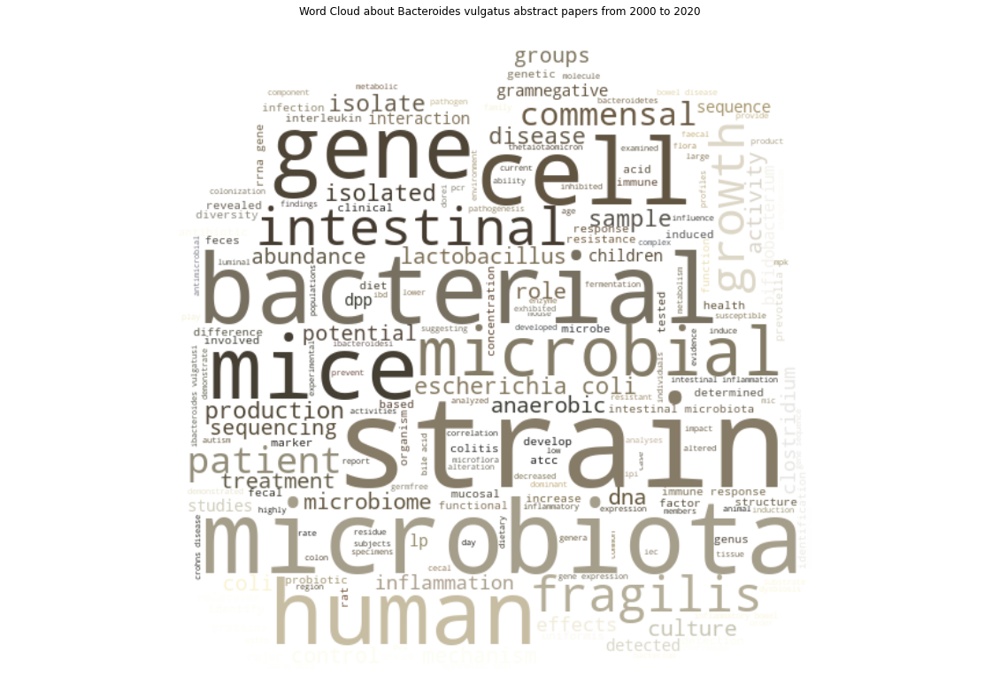

In [14]:
abstract_word_cloud(fetchs, [2000, 2020], 'Bacteroides vulgatus',path_vulgatus, summaries) 

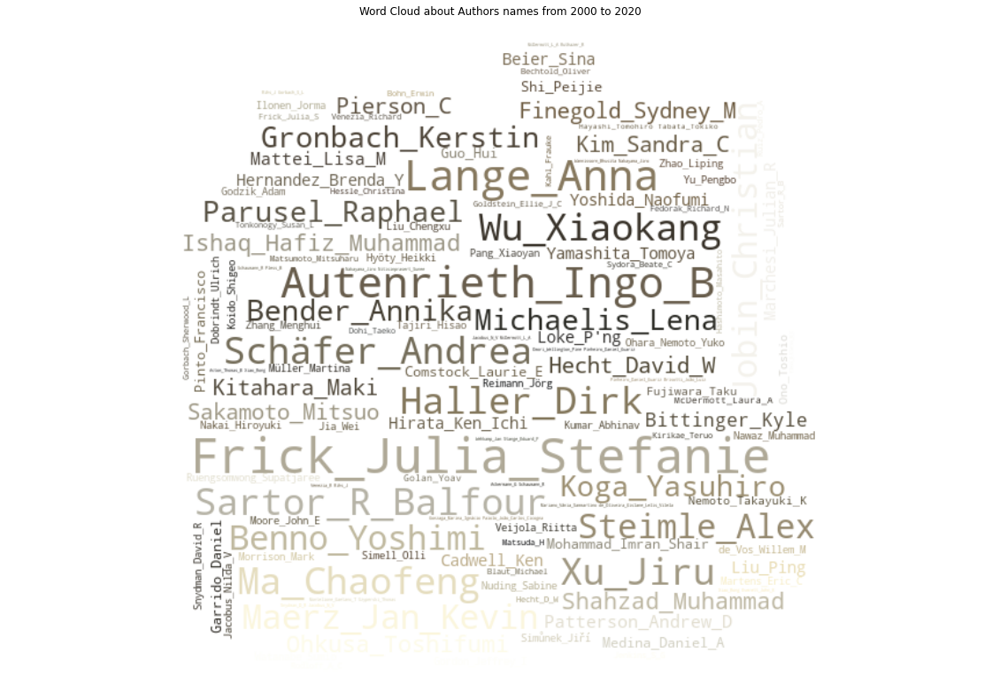

In [15]:
author_word_cloud(fetchs, [2000, 2020], path_vulgatus, summaries)

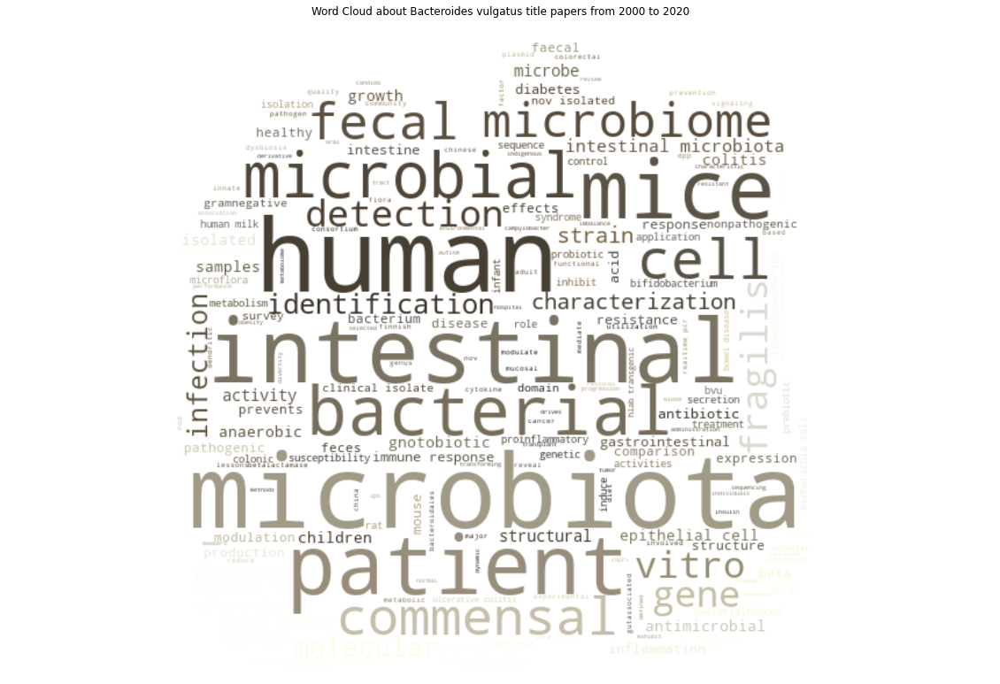

In [16]:
title_word_cloud(summaries, [2000, 2020], 'Bacteroides vulgatus',path_vulgatus) 

In [17]:
map_pc = folium_papers_country(fetchs,path_vulgatus)

In [18]:
map_pc

In [19]:
folium_dpt_country(fetchs, path_vulgatus)

In [20]:
top_journals(fetchs, path_vulgatus)

In [21]:
top_10_authors(fetchs, [], path_vulgatus)

In [22]:
top_organism(list(top_food_ill['sciname'].values), list(top_food_ill['accession'].values), "Top 10 organism food disturbed", "# accension", "organism", path_vulgatus) 

In [23]:
top_organism(list(top_mental_ill['sciname'].values), list(top_mental_ill['accession'].values), "Top 10 organism mental illness", "# accension", "organism", path_vulgatus) 

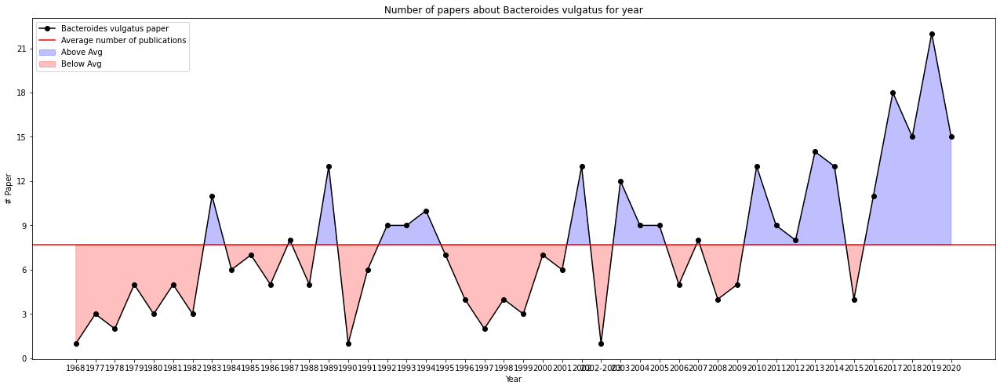

In [24]:
plot_num_per_date(summaries, 'Bacteroides vulgatus', path_vulgatus)

In [25]:
#Escherichia coli presente 12 volte in malattie mentali e 3 in disordini alimentari 
path_Escherichia = './images/Escherichia coli/'

In [26]:
ids_pubmed_ec = get_idList(esearch('pubmed', 'Escherichia coli[All Fields] AND gut', 400))
summaries_ec, fetchs_ec = get_data(ids_pubmed_ec, 'pubmed', 'Escherichia')

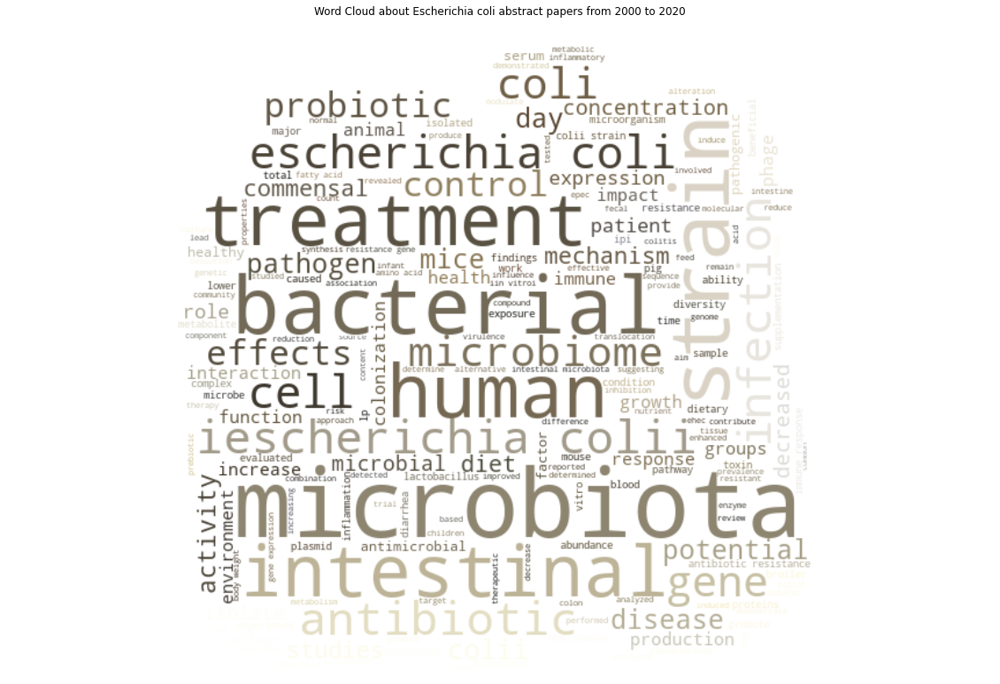

In [27]:
abstract_word_cloud(fetchs_ec, [2000, 2020], 'Escherichia coli',path_Escherichia, summaries_ec) 

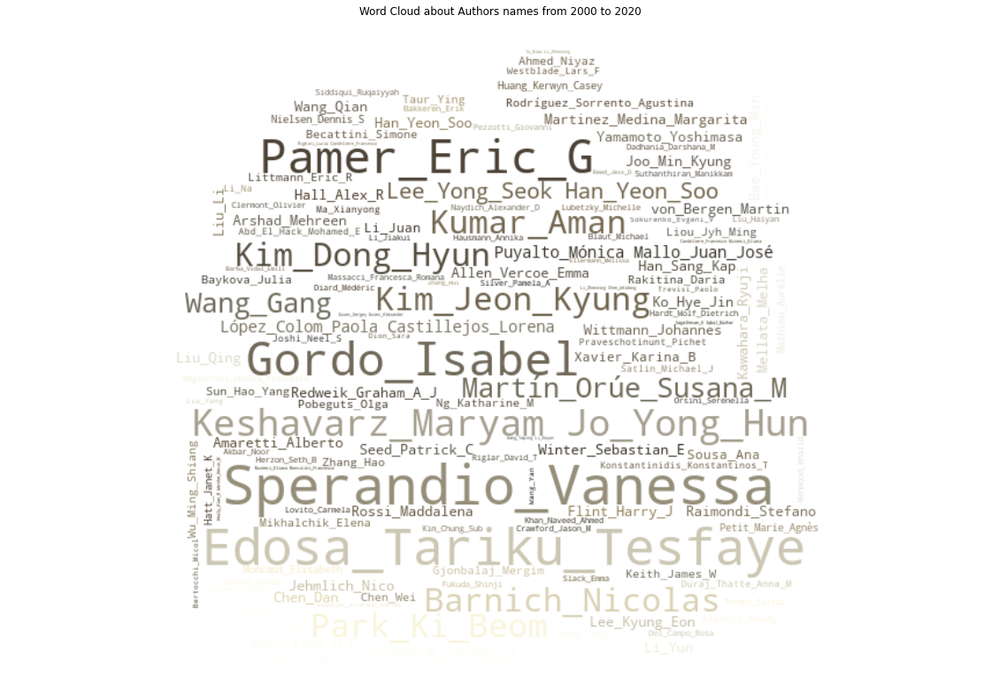

In [28]:
author_word_cloud(fetchs_ec, [2000, 2020], path_Escherichia, summaries_ec)

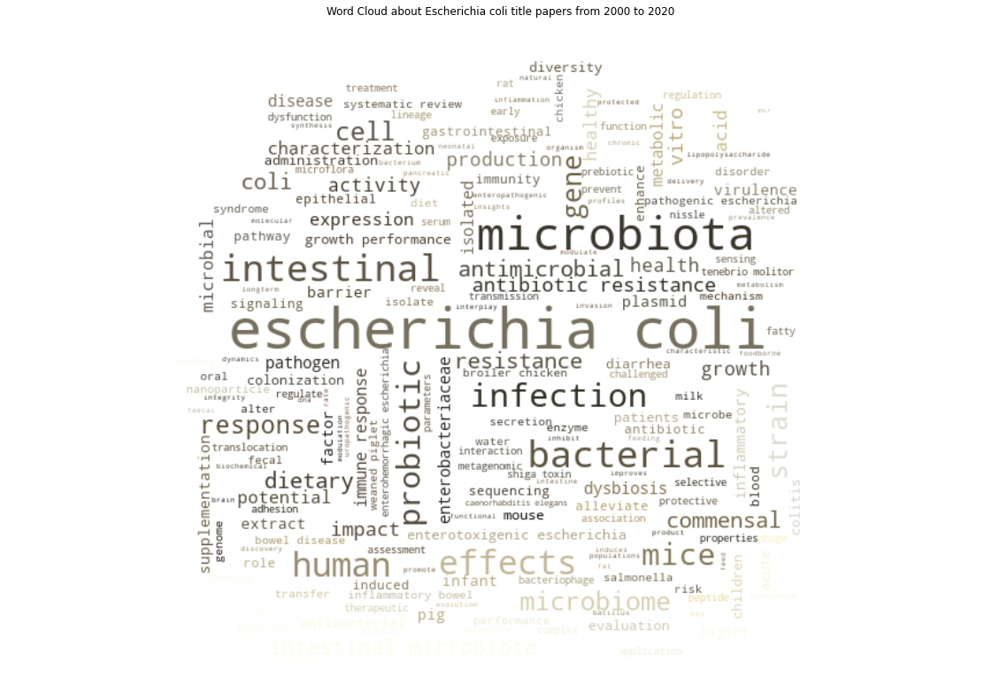

In [29]:
title_word_cloud(summaries_ec, [2000, 2020], 'Escherichia coli' ,path_Escherichia) 

In [30]:
folium_papers_country(fetchs_ec , path_Escherichia)

In [31]:
folium_dpt_country(fetchs_ec , path_Escherichia)

In [32]:
#top_journals(fetchs_ec, path_Escherichia)

In [33]:
top_10_authors(fetchs_ec, [], path_Escherichia)

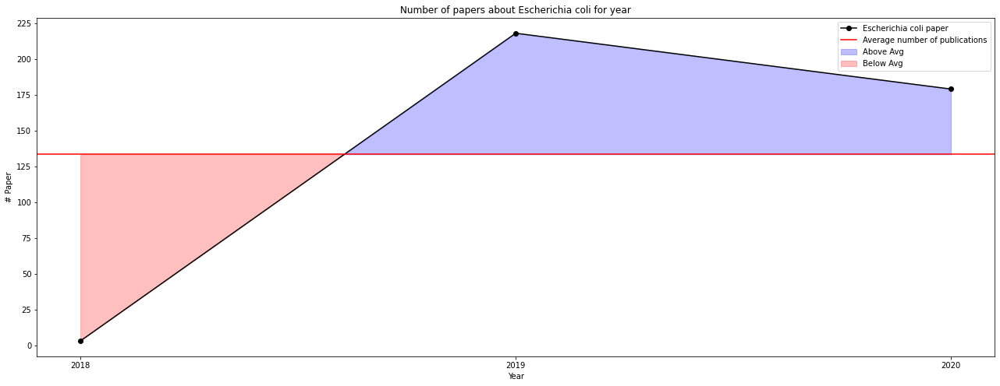

In [34]:
plot_num_per_date(summaries_ec,'Escherichia coli' ,path_Escherichia)

In [35]:
#Akkermansia muciniphila 3 volte in malattie mentali e 4 in disorsine alimentari 
path_Akkermansia = './images/Akkermansia muciniphila/'
ids_pubmed_am = get_idList(esearch('pubmed', 'Akkermansia muciniphila[All Fields]', 400))
summaries_am, fetchs_am = get_data(ids_pubmed_am, 'pubmed', 'Akkermansia')

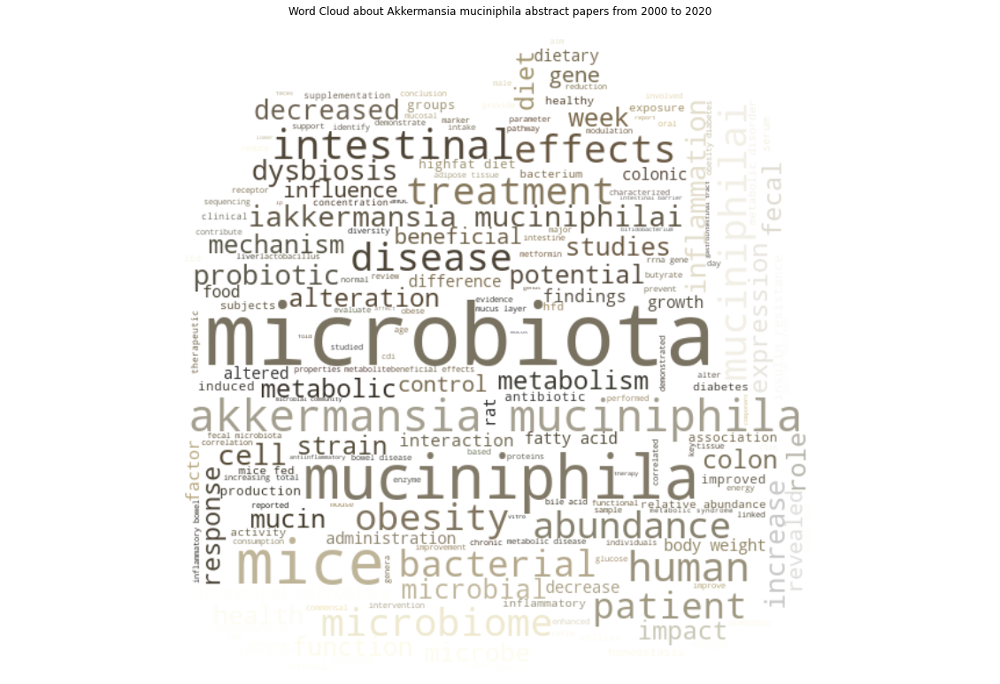

In [36]:
abstract_word_cloud(fetchs_am, [2000, 2020], 'Akkermansia muciniphila',path_Akkermansia, summaries_am) 

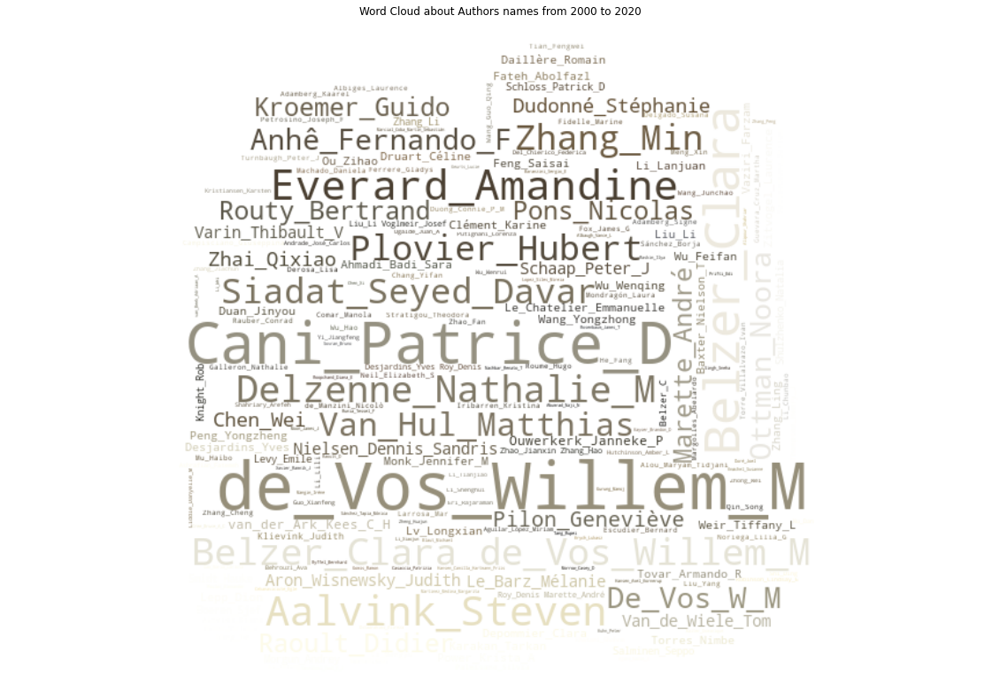

In [37]:
author_word_cloud(fetchs_am, [2000, 2020], path_Akkermansia, summaries_am)

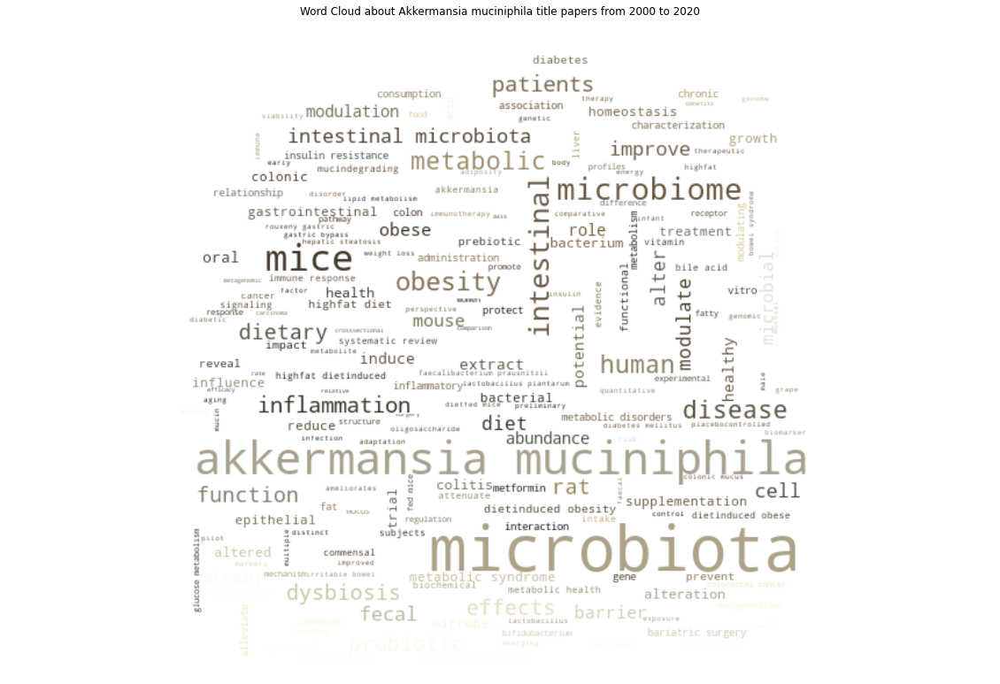

In [38]:
title_word_cloud(summaries_am, [2000, 2020], 'Akkermansia muciniphila',path_Akkermansia) 

In [39]:
folium_papers_country(fetchs_am , path_Akkermansia)

In [41]:
folium_dpt_country(fetchs_am, path_Akkermansia)

In [42]:
top_journals(fetchs_am, path_Akkermansia)

In [43]:
top_10_authors(fetchs_am, [], path_Akkermansia)

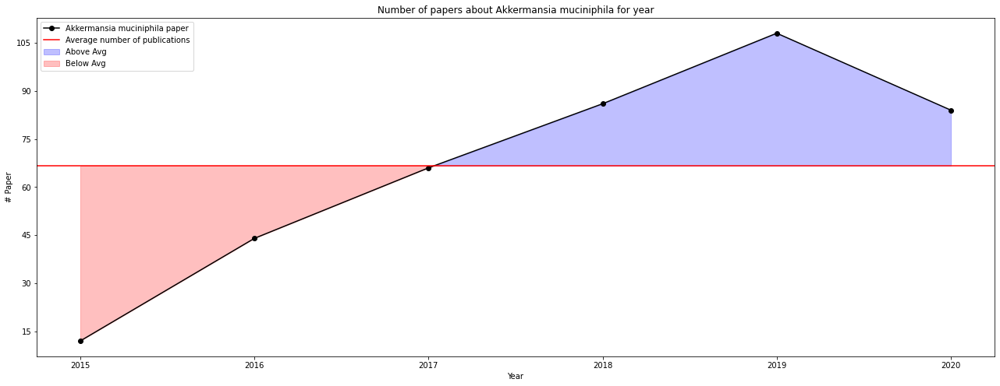

In [44]:
plot_num_per_date(summaries_am, 'Akkermansia muciniphila', path_Akkermansia)

In [45]:
#Faecalibacterium prausnitzii A2-165

In [46]:
path_Faecalibacterium = './images/Faecalibacterium prausnitzii A2-165/'
ids_pubmed_fp = get_idList(esearch('pubmed', 'Faecalibacterium prausnitzii A2-165[All Fields]', 400))
summaries_fp, fetchs_fp = get_data(ids_pubmed_fp, 'pubmed', 'Faecalibacterium')

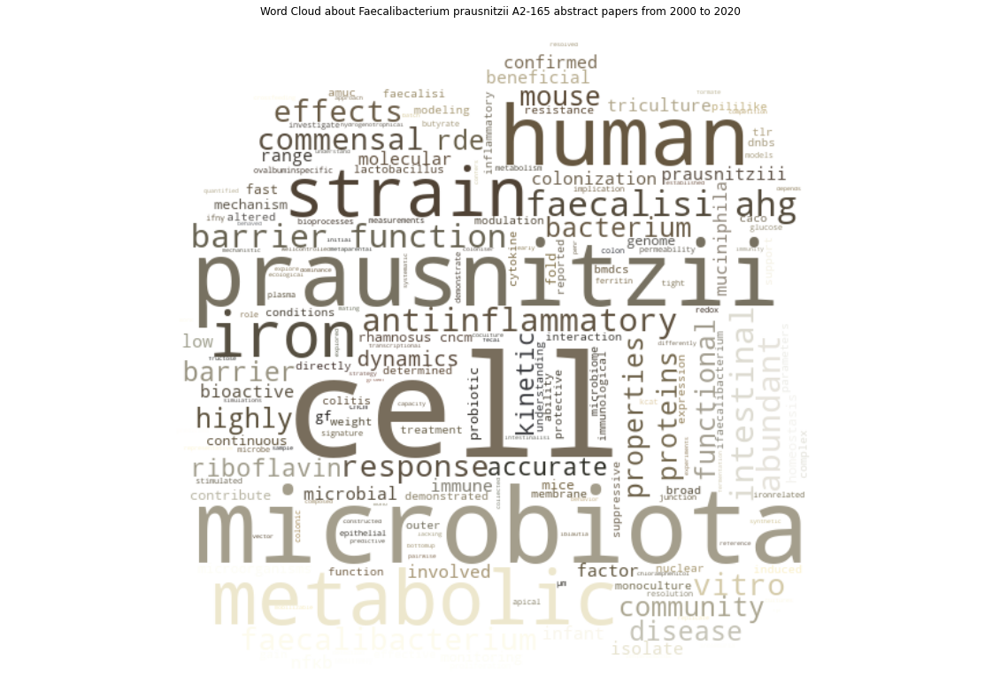

In [47]:
abstract_word_cloud(fetchs_fp, [2000, 2020], 'Faecalibacterium prausnitzii A2-165',path_Faecalibacterium, summaries_fp) 

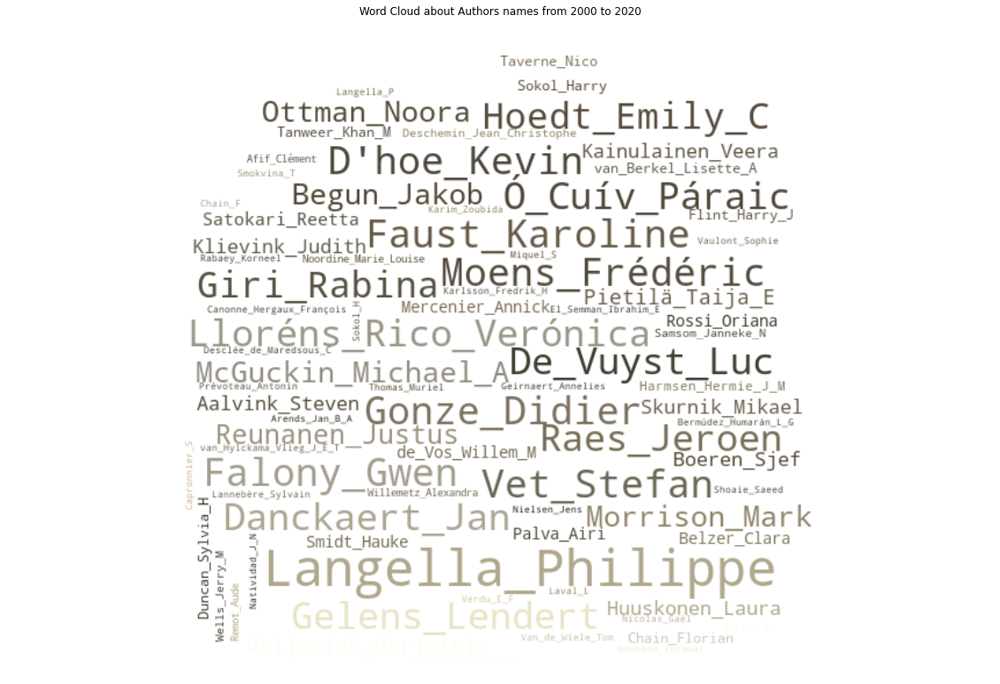

In [48]:
author_word_cloud(fetchs_fp, [2000, 2020], path_Faecalibacterium, summaries_fp)

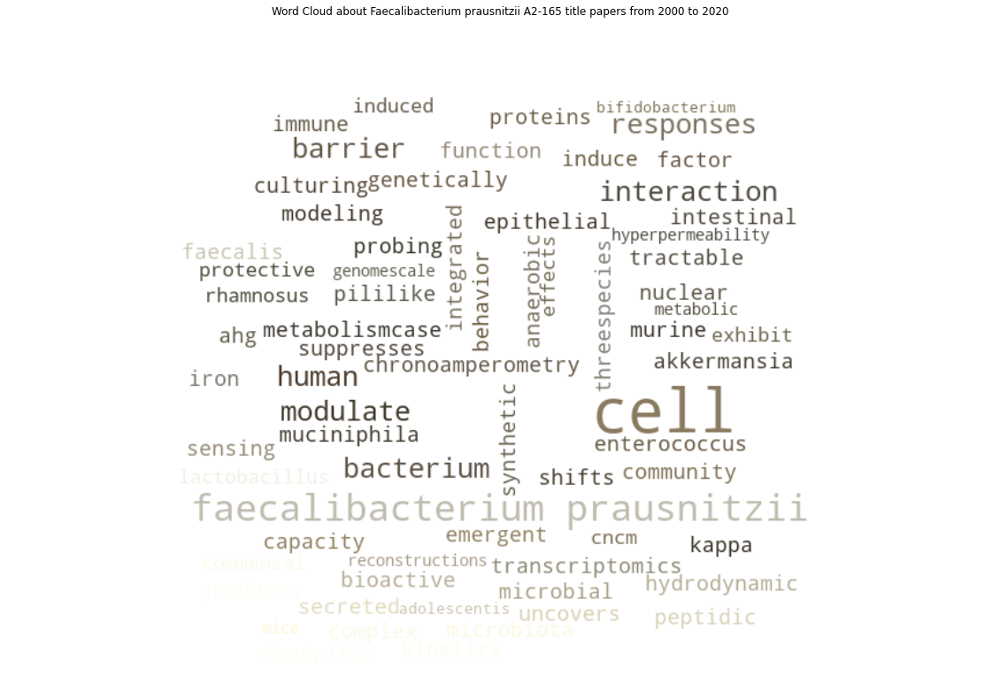

In [49]:
title_word_cloud(summaries_fp, [2000, 2020], 'Faecalibacterium prausnitzii A2-165' ,path_Faecalibacterium) 

In [50]:
folium_papers_country(fetchs_fp , path_Faecalibacterium)

In [51]:
folium_dpt_country(fetchs_fp, path_Faecalibacterium)

In [52]:
top_10_authors(fetchs_fp, [], path_Faecalibacterium)

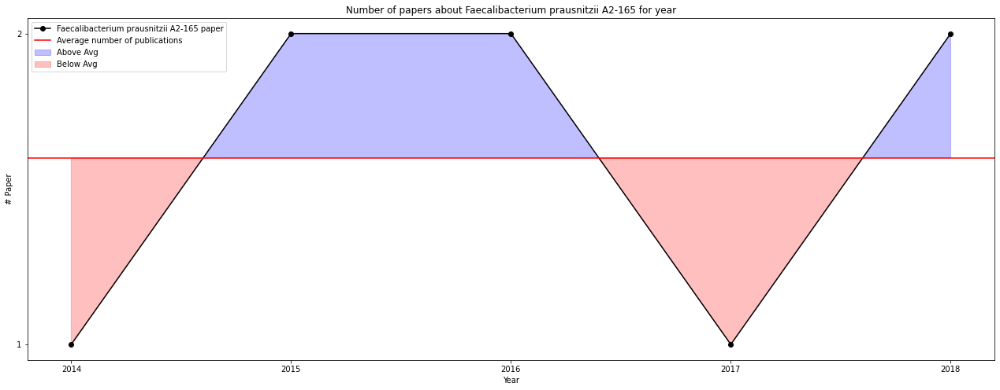

In [53]:
plot_num_per_date(summaries_fp, 'Faecalibacterium prausnitzii A2-165', path_Faecalibacterium)

In [54]:
top_journals(fetchs_fp, path_Faecalibacterium)

In [55]:
#Bacteroides dorei 3 volte in entrambi 

In [56]:
path_Bacteroides = './images/Bacteroides dorei/'
ids_pubmed_bd = get_idList(esearch('pubmed', 'Bacteroides dorei[All Fields]', 400))
summaries_bd, fetchs_bd = get_data(ids_pubmed_bd, 'pubmed', 'Bacteroides')

In [57]:
top_journals(fetchs_bd, path_Bacteroides)

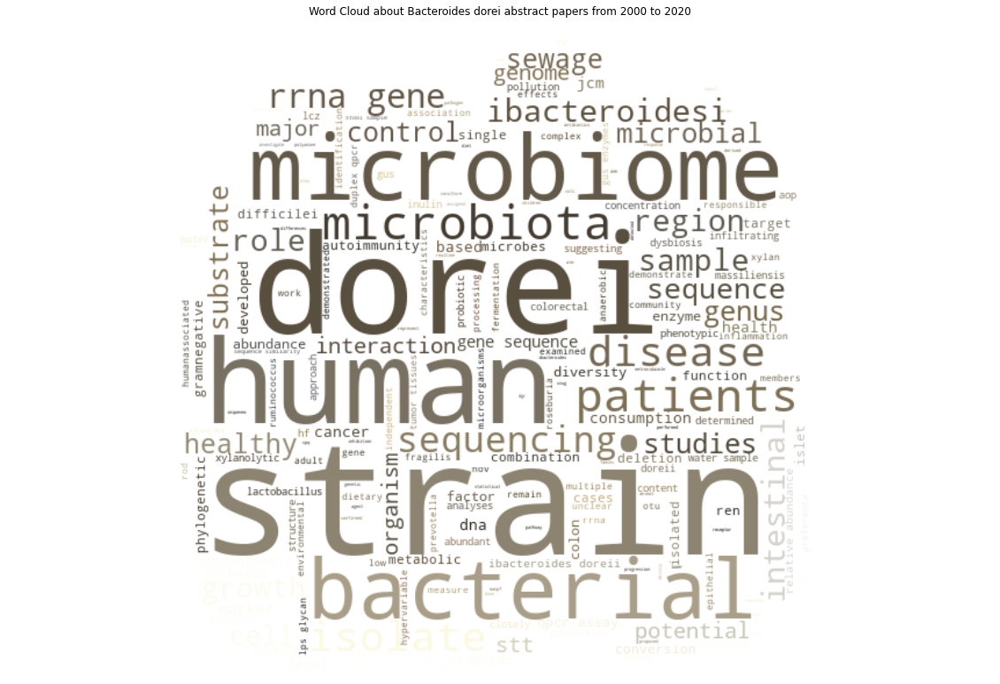

In [58]:
abstract_word_cloud(fetchs_bd, [2000, 2020], 'Bacteroides dorei',path_Bacteroides, summaries_bd) 

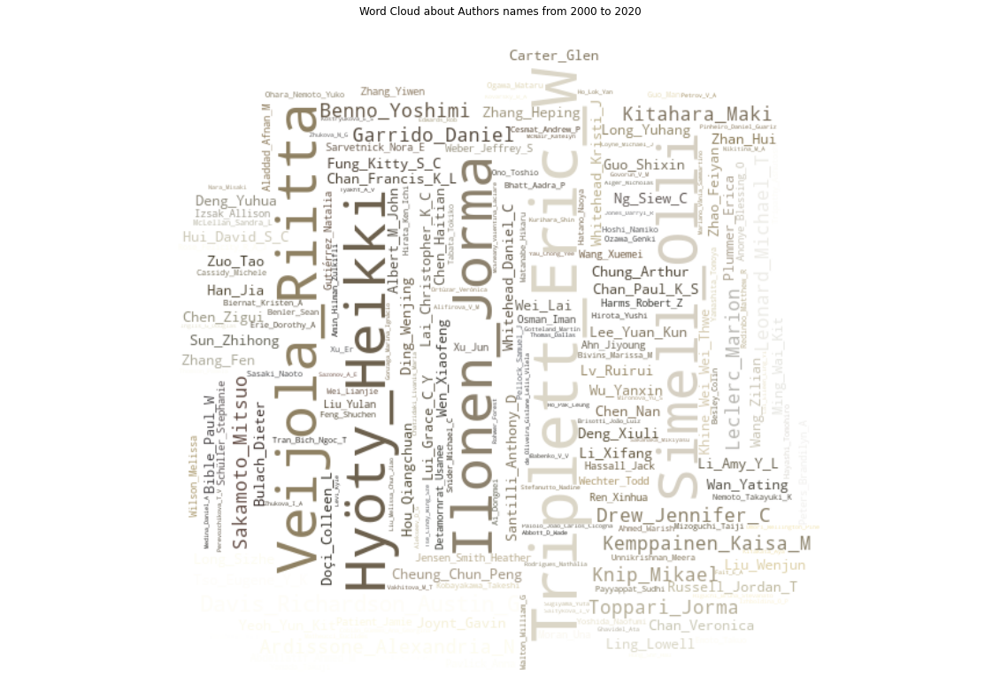

In [59]:
author_word_cloud(fetchs_bd, [2000, 2020], path_Bacteroides, summaries_bd)

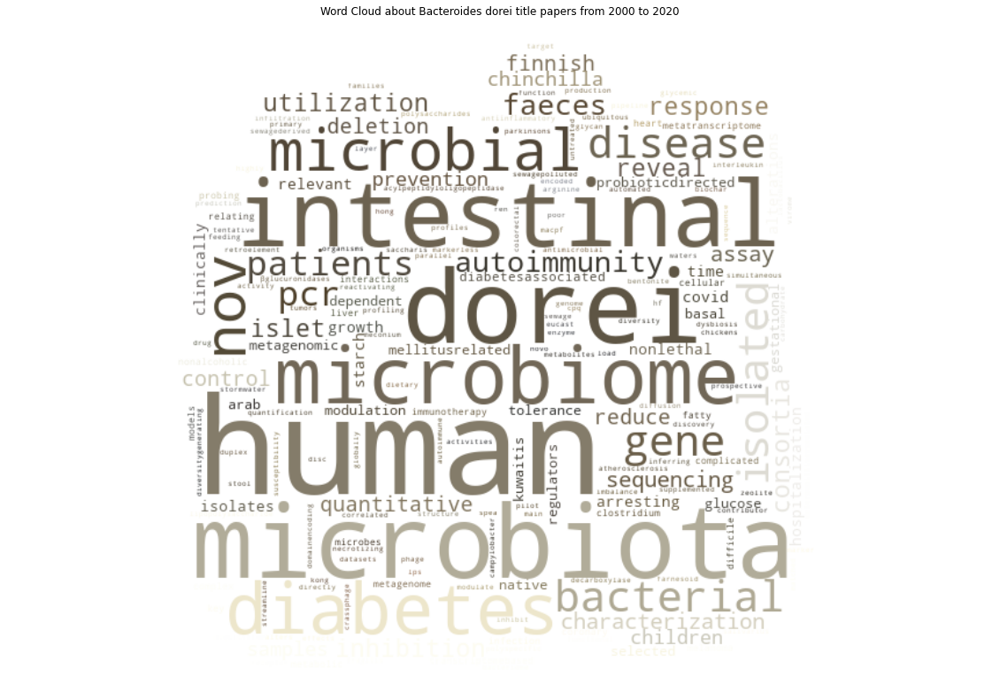

In [60]:
title_word_cloud(summaries_bd, [2000, 2020], 'Bacteroides dorei' ,path_Bacteroides)

In [61]:
folium_papers_country(fetchs_bd , path_Bacteroides)

In [62]:
folium_dpt_country(fetchs_bd, path_Bacteroides)

In [63]:
top_10_authors(fetchs_bd, [], path_Faecalibacterium)

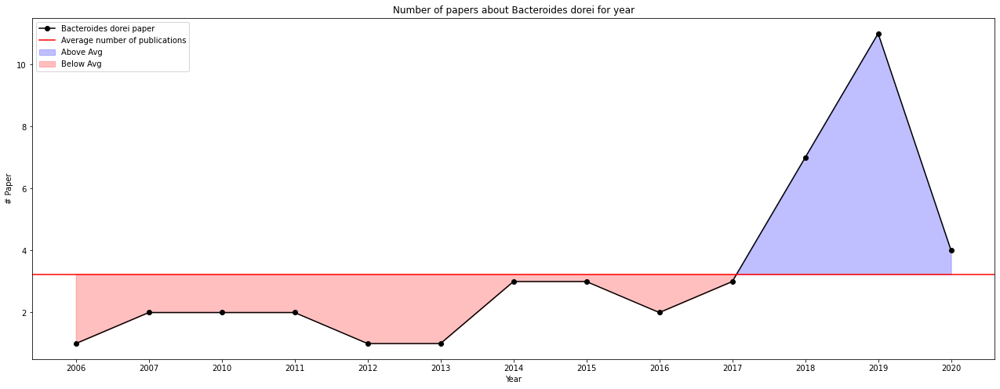

In [64]:
plot_num_per_date(summaries_bd, 'Bacteroides dorei' ,path_Bacteroides)

In [65]:
#organismo presente sono in mental ilness 10 volte 
#Pseudomonas fragi

In [66]:
path_Pseudomonas = './images/Pseudomonas fragi/'
ids_pubmed_fragi = get_idList(esearch('pubmed', 'Pseudomonas fragi[All Fields]', 400))
summaries_fragi, fetchs_fragi = get_data(ids_pubmed_fragi, 'pubmed', 'fragi')

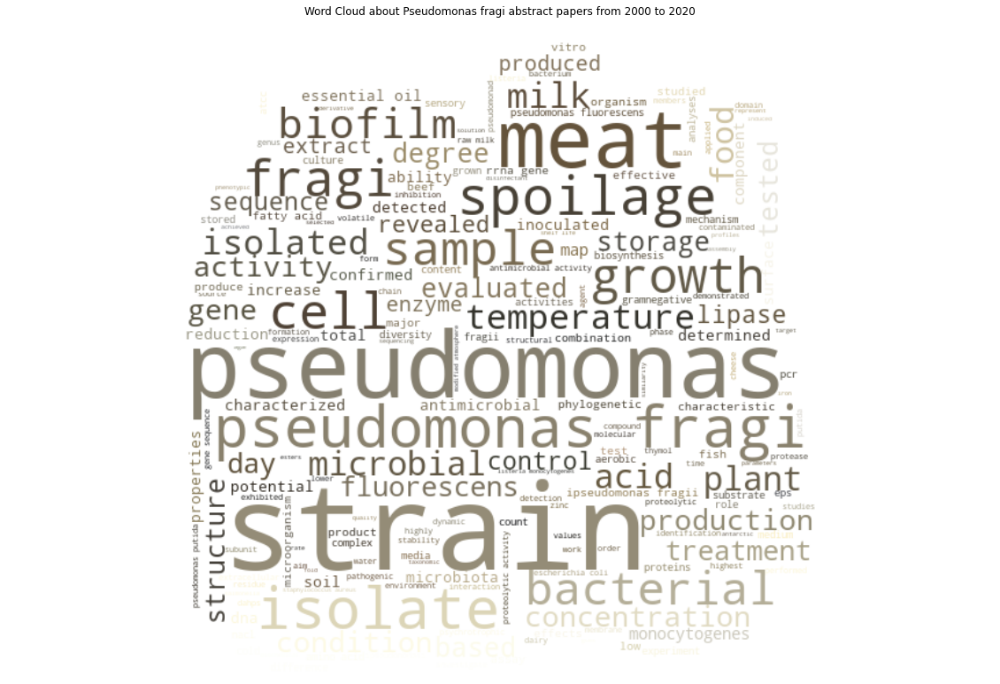

In [67]:
abstract_word_cloud(fetchs_fragi, [2000, 2020], 'Pseudomonas fragi',path_Pseudomonas, summaries_fragi) 

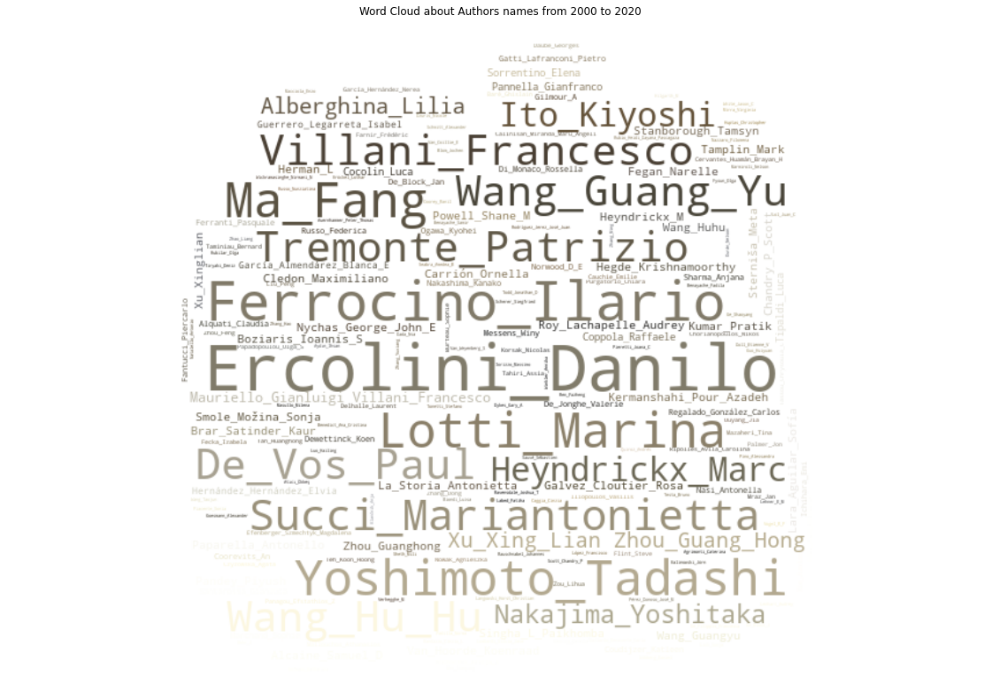

In [68]:
author_word_cloud(fetchs_fragi, [2000, 2020], path_Pseudomonas, summaries_fragi)

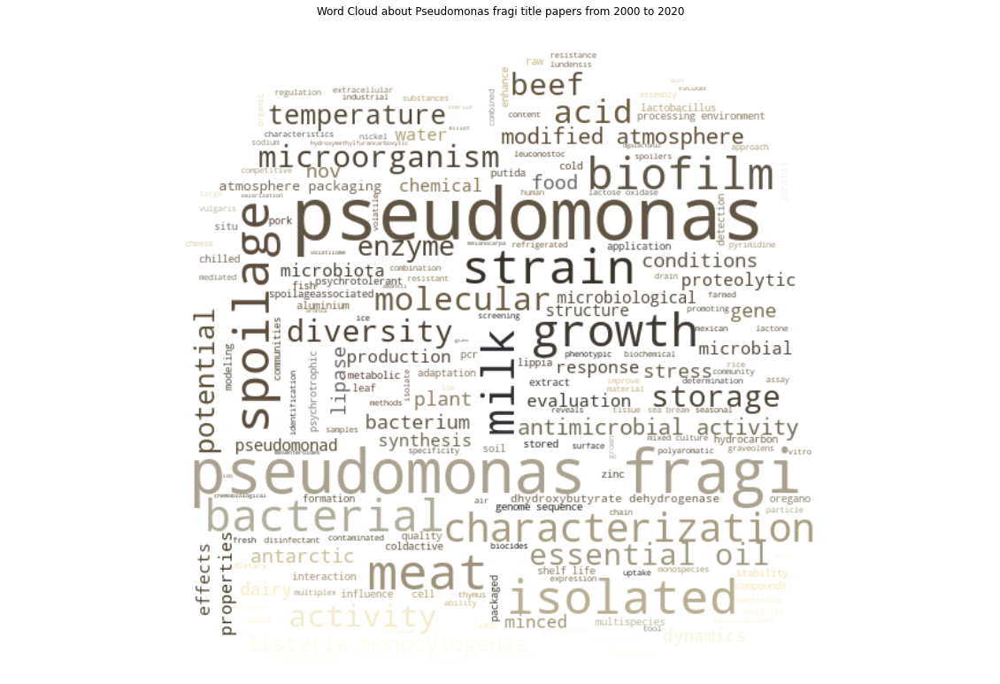

In [69]:
title_word_cloud(summaries_fragi, [2000, 2020], 'Pseudomonas fragi' ,path_Pseudomonas)

In [70]:
folium_papers_country(fetchs_fragi , path_Pseudomonas)

In [71]:
folium_dpt_country(fetchs_fragi, path_Pseudomonas)

In [72]:
top_10_authors(fetchs_fragi, [], path_Pseudomonas)

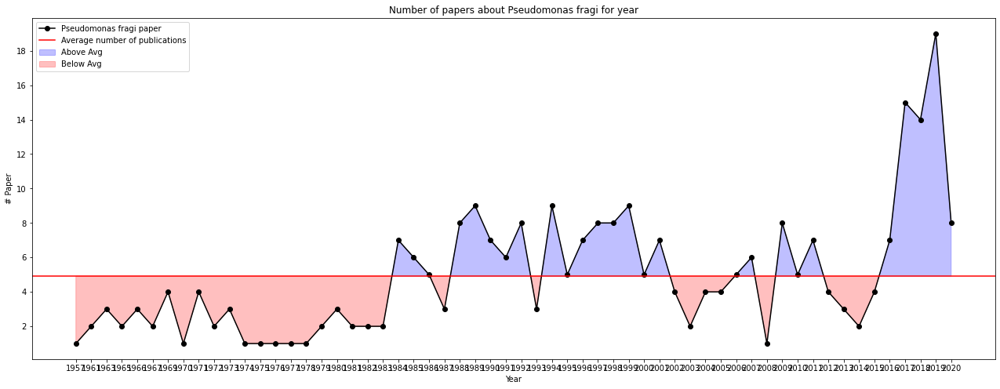

In [73]:
plot_num_per_date(summaries_fragi, 'Pseudomonas fragi' ,path_Pseudomonas)

In [74]:
top_journals(fetchs_fragi, path_Pseudomonas)

In [75]:
#organismo presente solo in disturbi alimentari Ruminococcus gnavus
path_Ruminococcus = './images/Ruminococcus gnavus/'
ids_pubmed_rg = get_idList(esearch('pubmed', 'Ruminococcus gnavus[All Fields]', 400))
summaries_rg, fetchs_rg = get_data(ids_pubmed_rg, 'pubmed', 'rg')

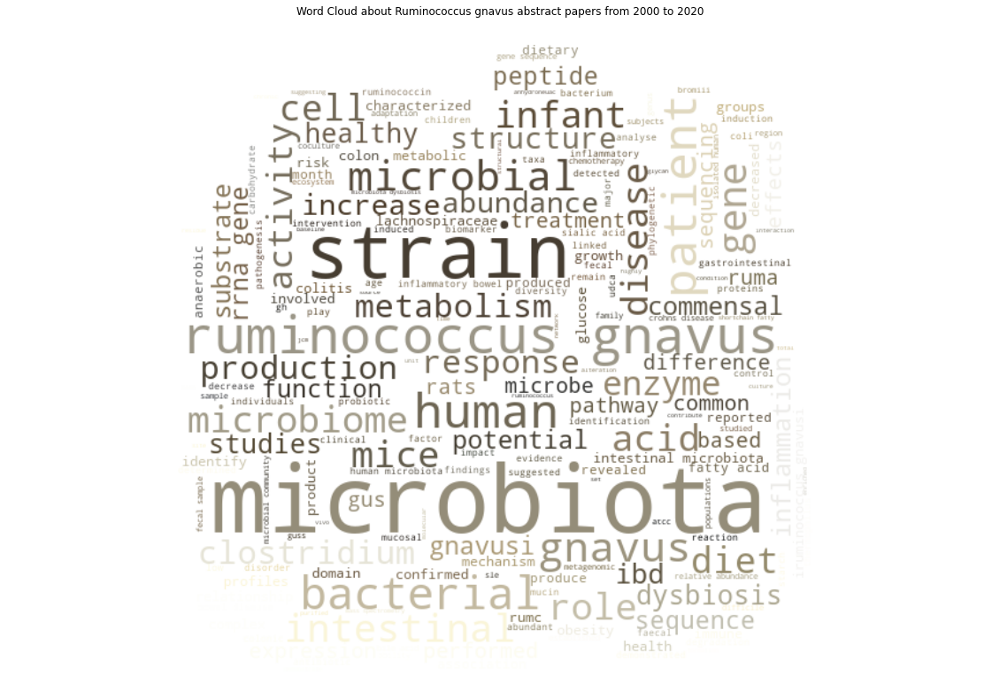

In [76]:
abstract_word_cloud(fetchs_rg, [2000, 2020], 'Ruminococcus gnavus',path_Ruminococcus, summaries_rg) 

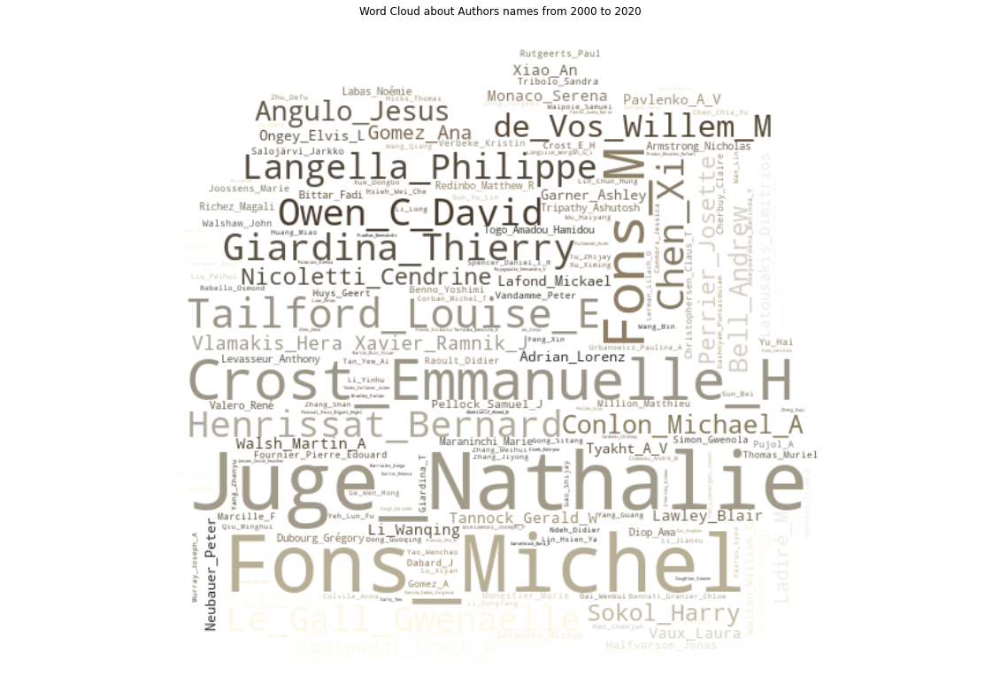

In [77]:
author_word_cloud(fetchs_rg, [2000, 2020], path_Ruminococcus, summaries_rg)

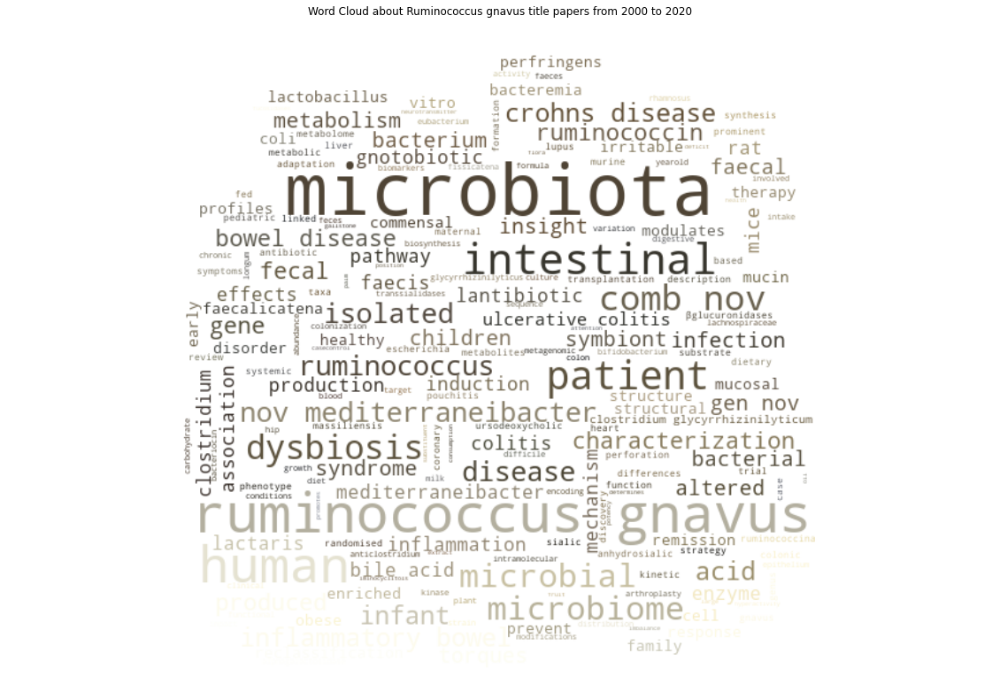

In [78]:
title_word_cloud(summaries_rg, [2000, 2020], 'Ruminococcus gnavus' ,path_Ruminococcus)

In [79]:
folium_papers_country(fetchs_rg , path_Ruminococcus)

In [80]:
folium_dpt_country(fetchs_rg, path_Ruminococcus)

In [81]:
top_10_authors(fetchs_rg, [], path_Ruminococcus)

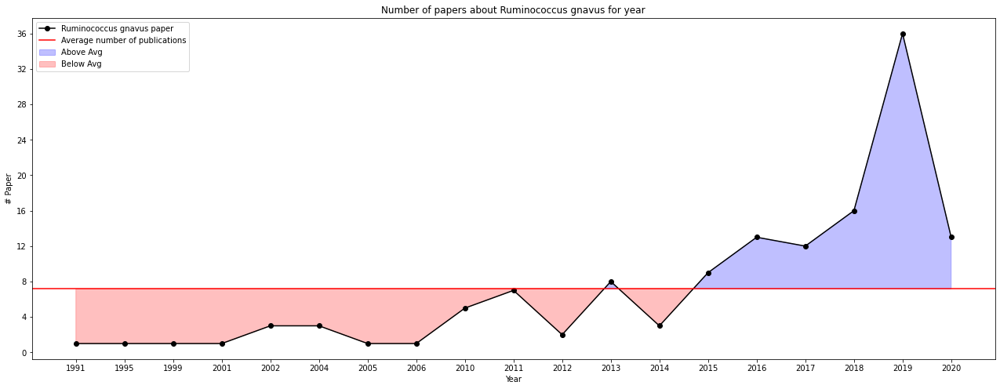

In [82]:
plot_num_per_date(summaries_rg, 'Ruminococcus gnavus' ,path_Ruminococcus)

In [83]:
top_journals(fetchs_rg, path_Ruminococcus)

In [35]:
def pipeline_analysis(path, organism, query):
    ids_pubmed = get_idList(esearch('pubmed', query, 400))
    summaries, fetchs = get_data(ids_pubmed, 'pubmed', organism)
    abstract_word_cloud(fetchs, [2000, 2020], organism,path, summaries)
    author_word_cloud(fetchs, [2000, 2020], path, summaries)
    title_word_cloud(summaries, [2000, 2020], organism ,path)
    m1 = folium_papers_country(fetchs , path)
    m2 = folium_dpt_country(fetchs, path)
    plot_num_per_date(summaries, organism ,path)
    top_10_authors(fetchs, [], path)
    top_journals(fetchs, path)
    return m1, m2
    

In [85]:
#analisi malati giovani vs malati anziani 

In [86]:
not_healthy_old = "./data/final_blast_top_sequences_not_healthy_old.tsv"
not_healthy_young = "./data/final_blast_top_sequences_not_healthy_young.tsv"
top_not_healthy_old, top_not_healthy_young , _, _, _ = load_data(not_healthy_old, not_healthy_young)

In [87]:
path_top = './images/'

In [88]:
top_organism(list(top_not_healthy_old['sciname'].values), list(top_not_healthy_old['accession'].values), "Top 10 organism not healthy old", "# accension", "organism", path_top) 

In [89]:
top_organism(list(top_not_healthy_young['sciname'].values), list(top_not_healthy_young['accession'].values), "Top 10 organism not healthy young", "# accension", "organism", path_top) 

In [90]:
#organismi in comune 

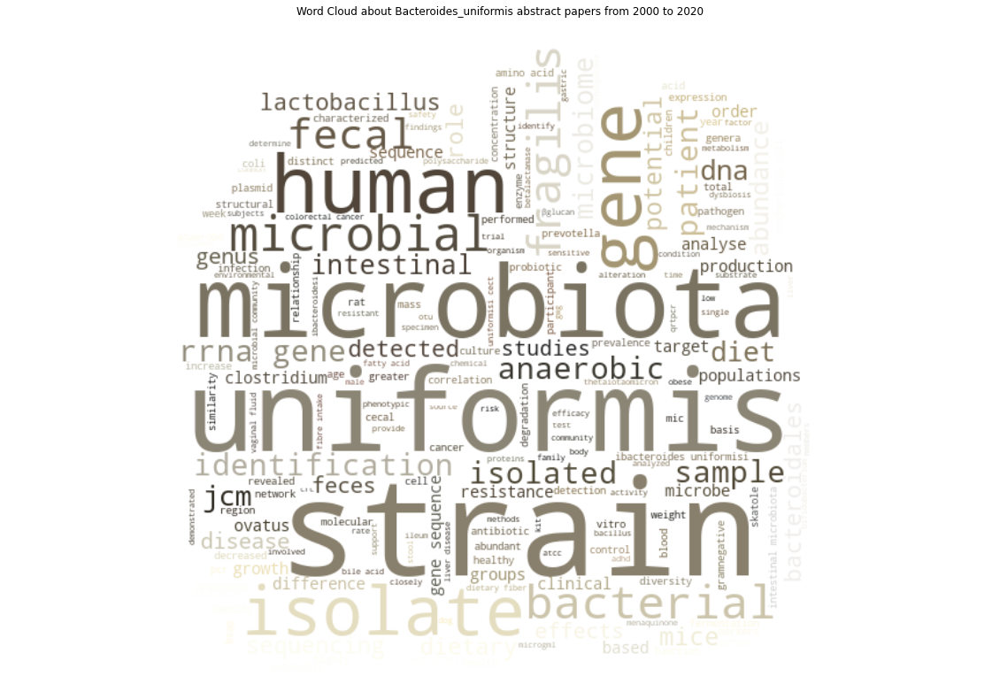

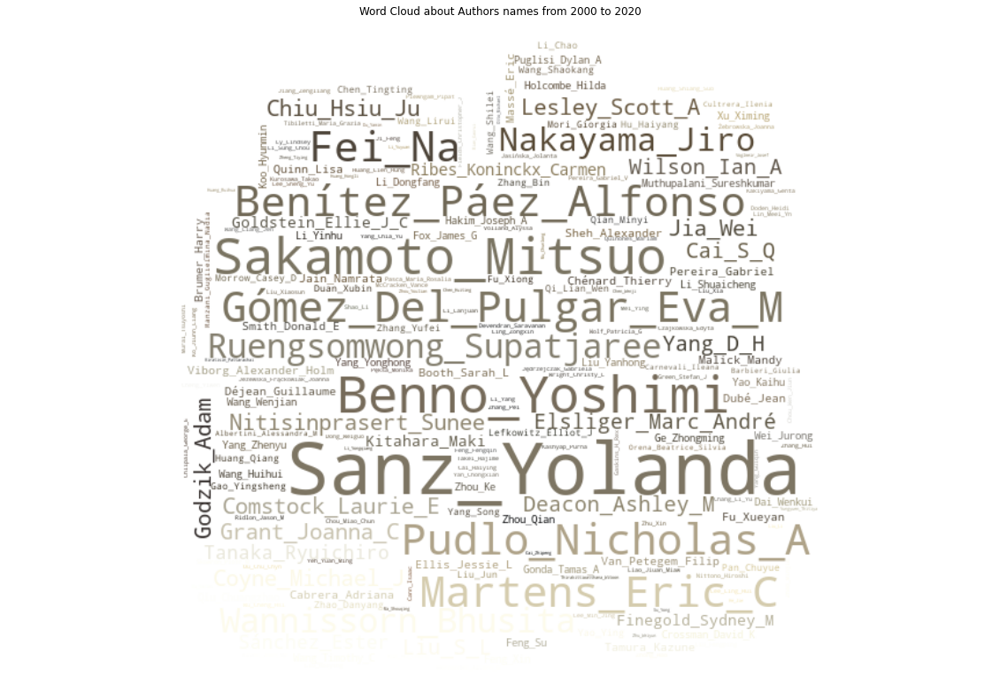

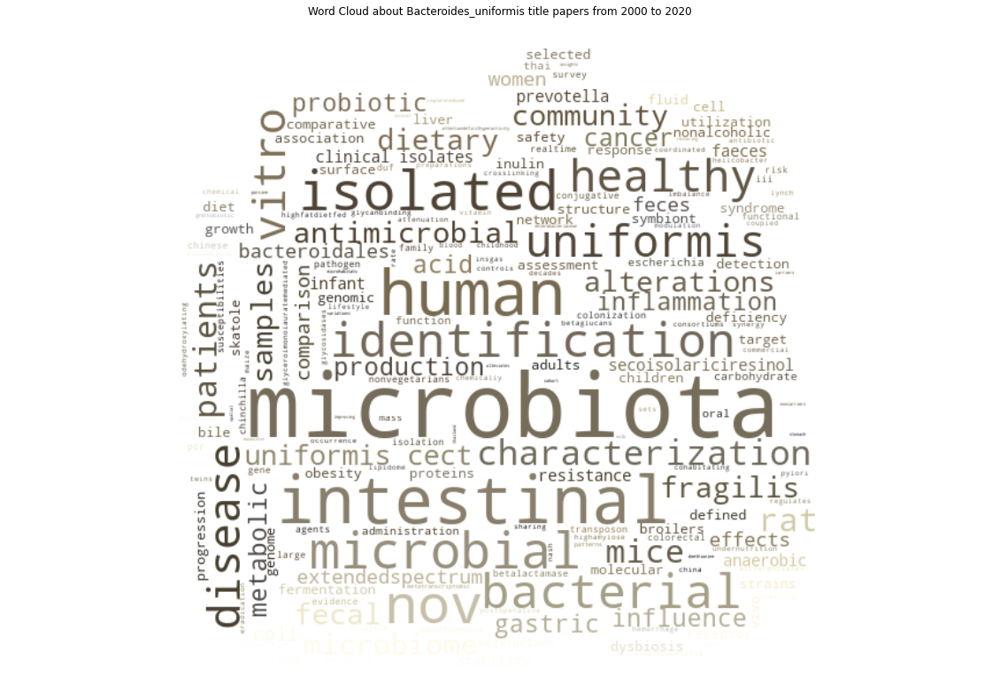

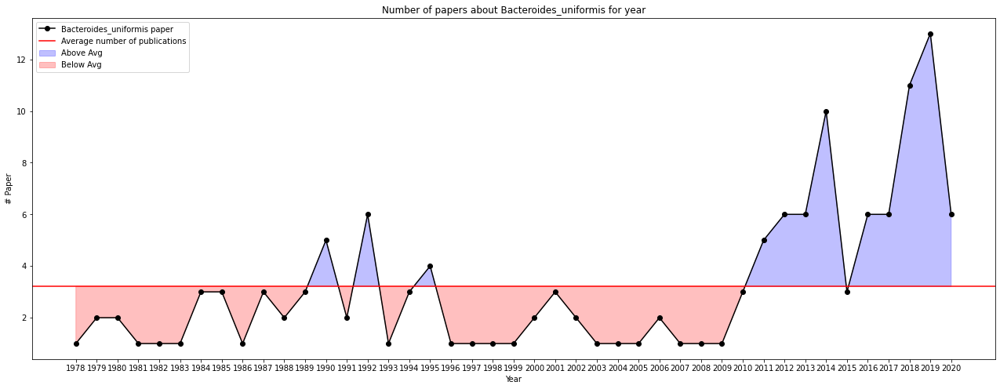

In [91]:
#Bacteroides uniformis
path_uniformis = './images/Bacteroides uniformis/'
query_uniformis = 'Bacteroides uniformis[All Fields]'
m_papers, m_dpt = pipeline_analysis(path_uniformis, 'Bacteroides_uniformis', query_uniformis)

In [92]:
m_papers

In [93]:
m_dpt

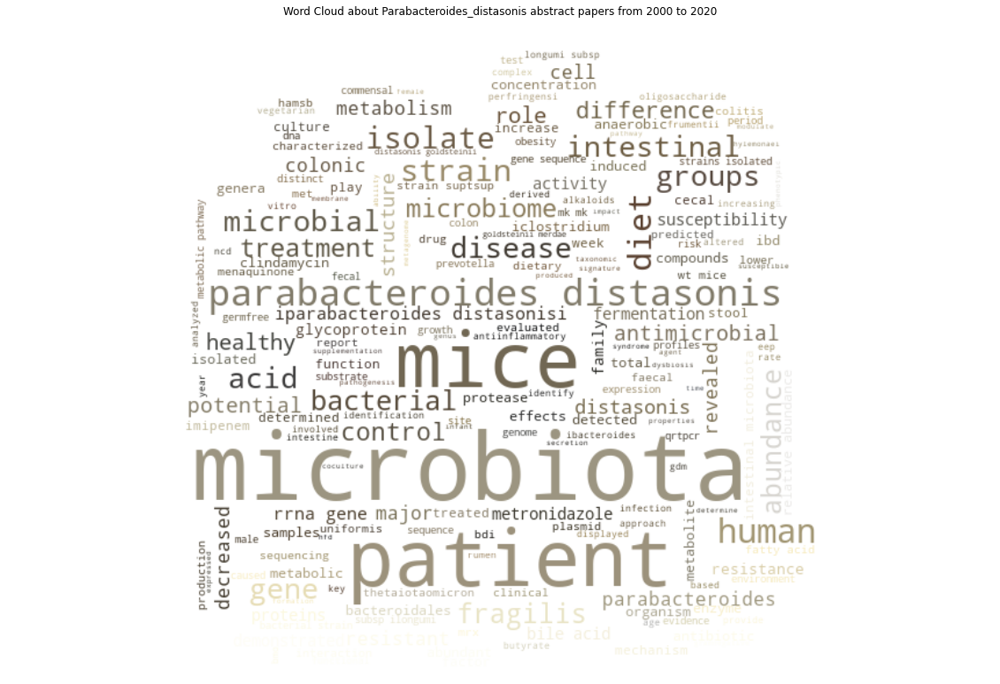

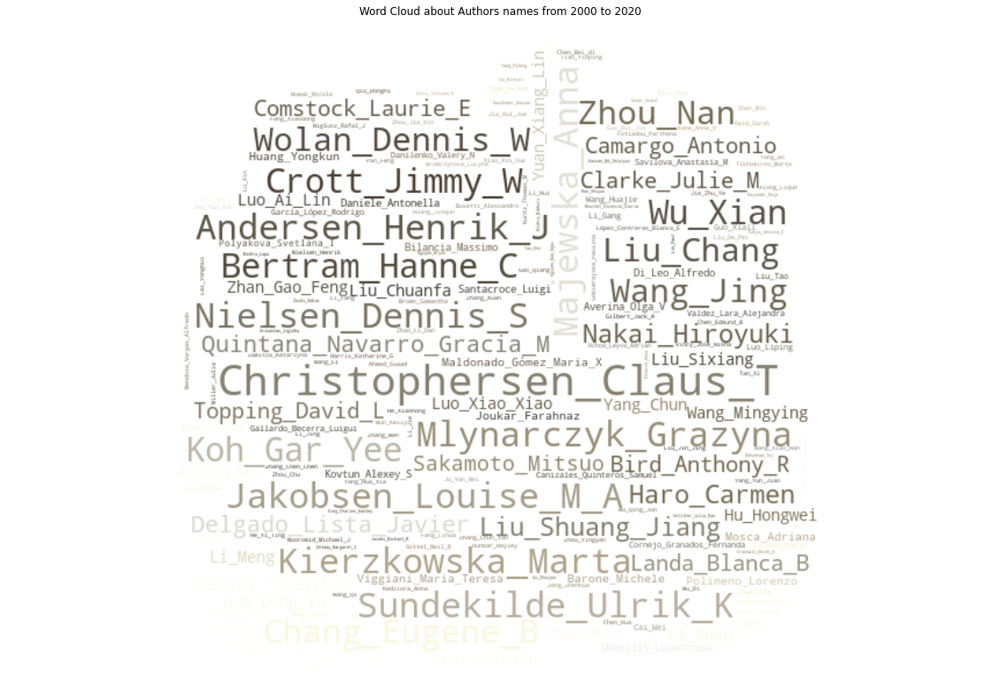

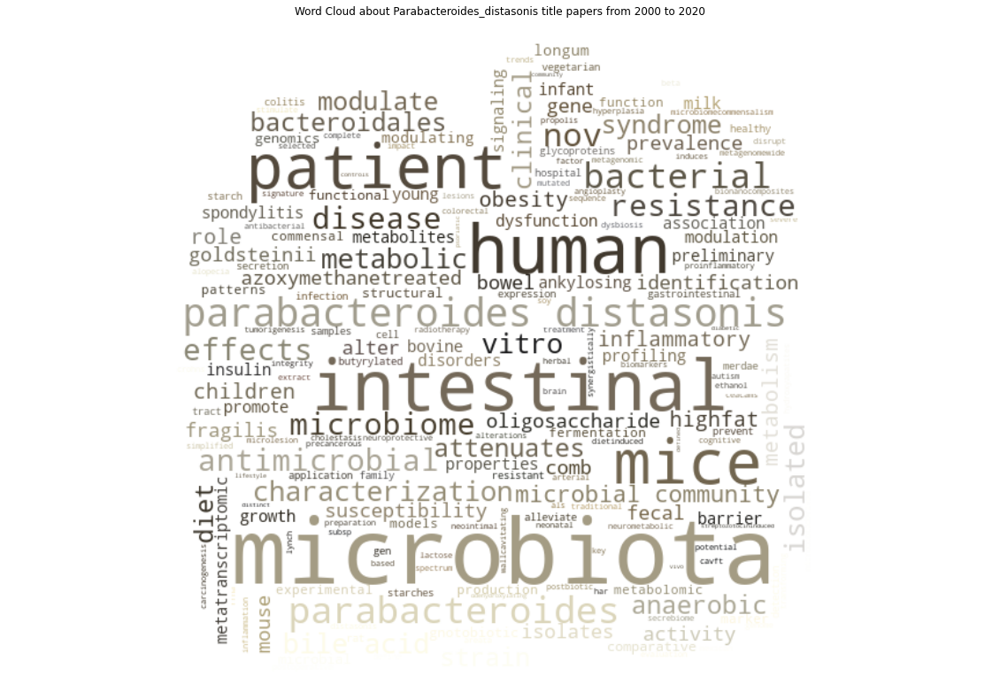

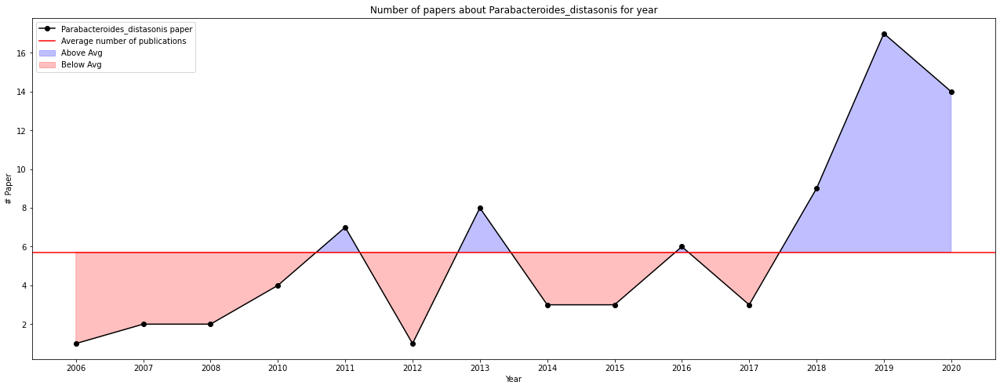

In [94]:
#parabacteroides distasonis
path_parabacteroides = './images/Parabacteroides distasonis/'
query_parabacteroides = 'Parabacteroides distasonis[All Fields]'
m_papers_parabacteroides, m_dpt_parabacteroides = pipeline_analysis(path_parabacteroides, 'Parabacteroides_distasonis', query_parabacteroides)

In [95]:
m_papers_parabacteroides

In [96]:
m_dpt_parabacteroides

In [97]:
#organismo solo in not healthy old bacteroides stercoris

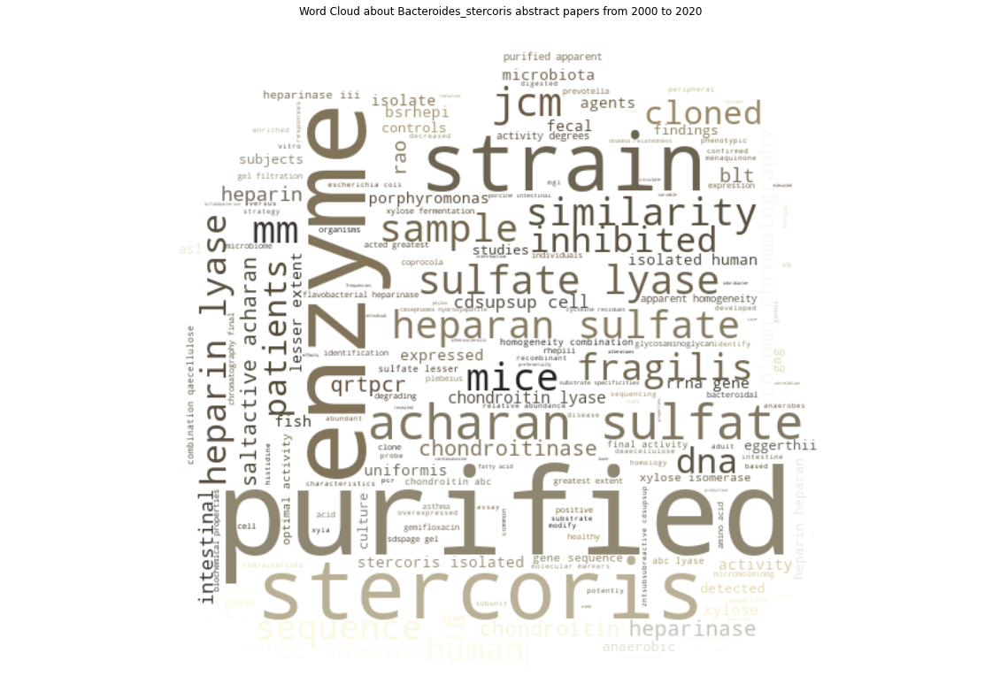

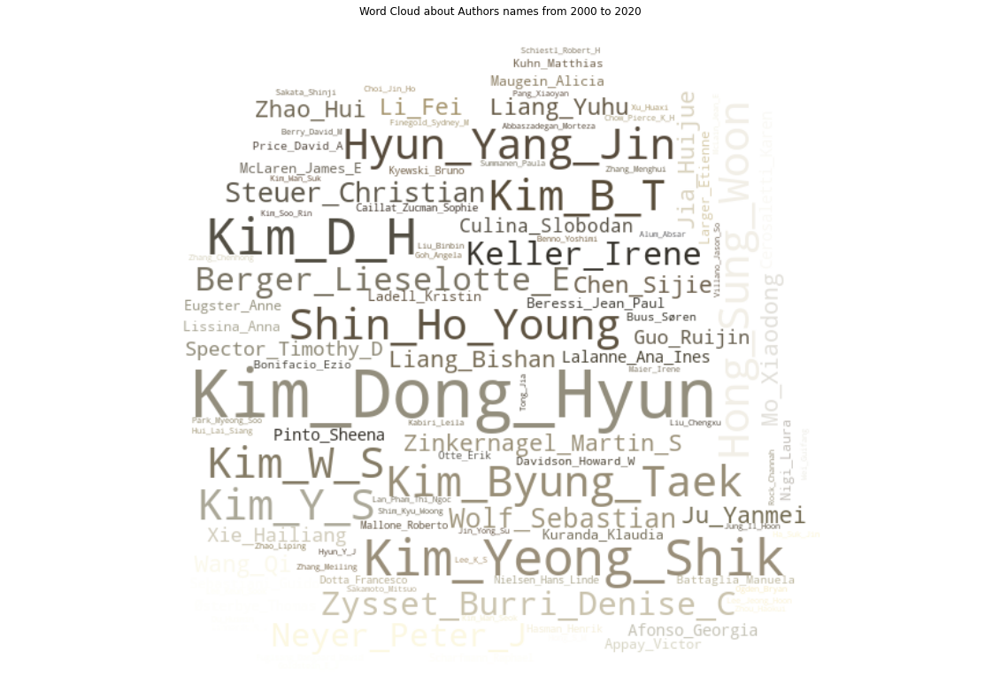

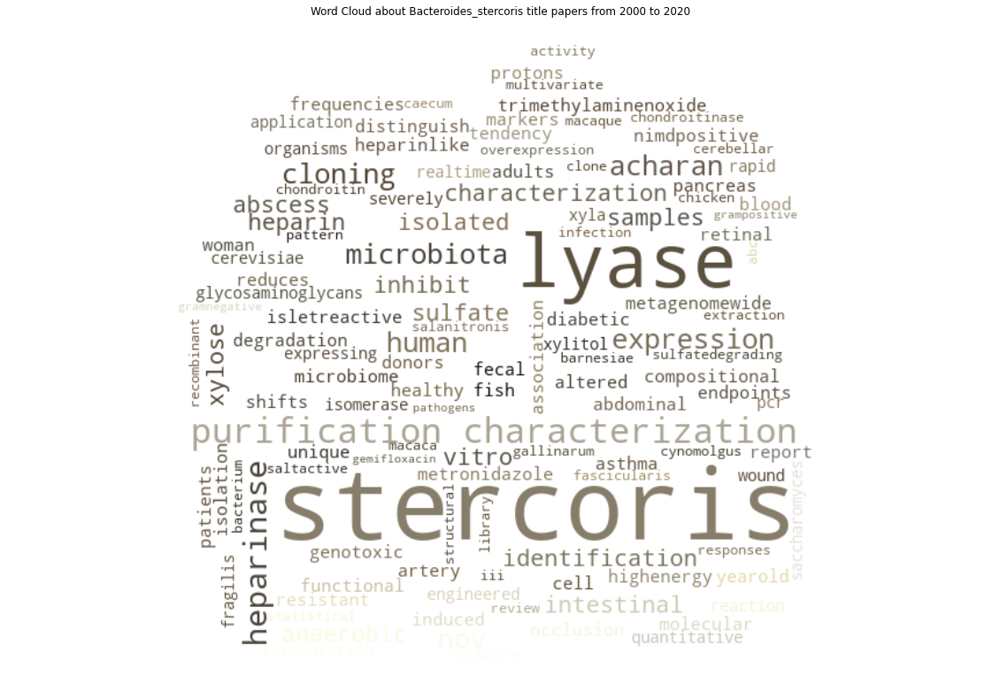

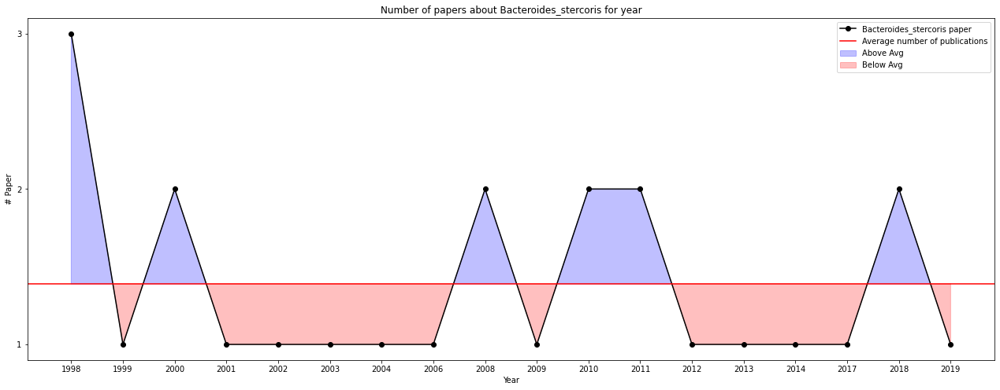

In [98]:

path_stercoris = './images/Bacteroides stercoris/'
query_stercoris = 'Bacteroides stercoris[All Fields]'
m_papers_stercoris, m_dpt_stercoris = pipeline_analysis(path_stercoris, 'Bacteroides_stercoris', query_stercoris)

In [99]:
m_papers_stercoris

In [100]:
m_dpt_stercoris

In [101]:
#organismo solo in not healthy young megamonas funiformis

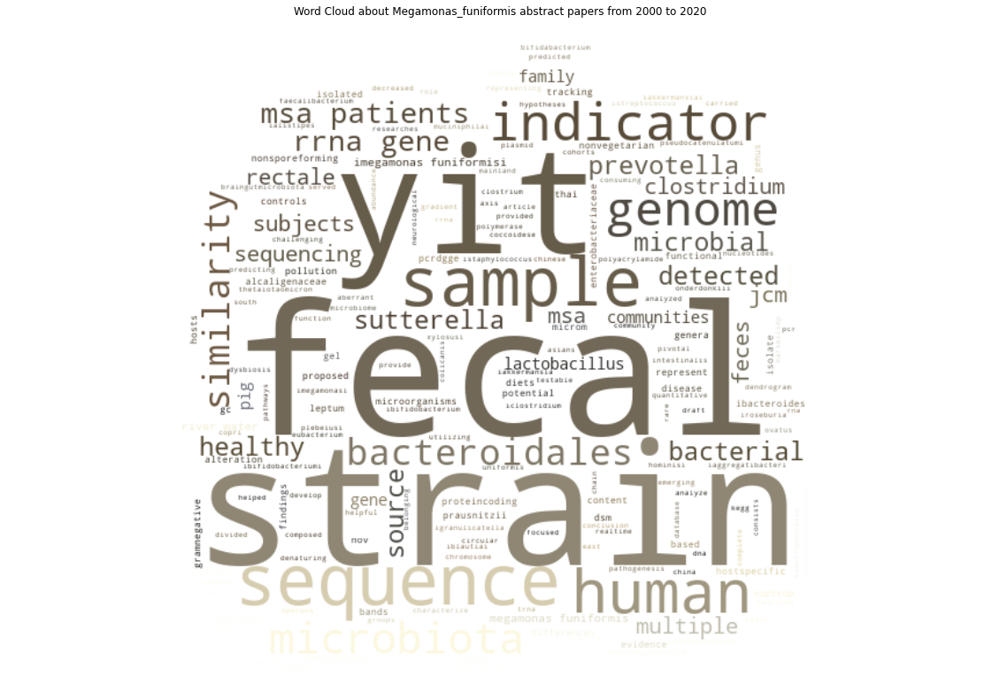

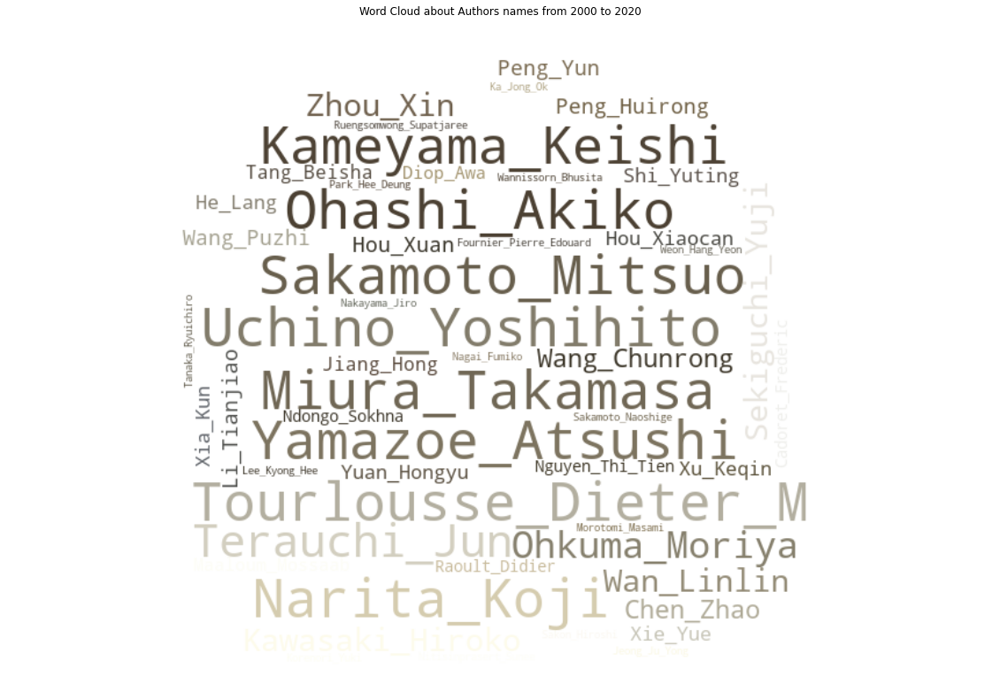

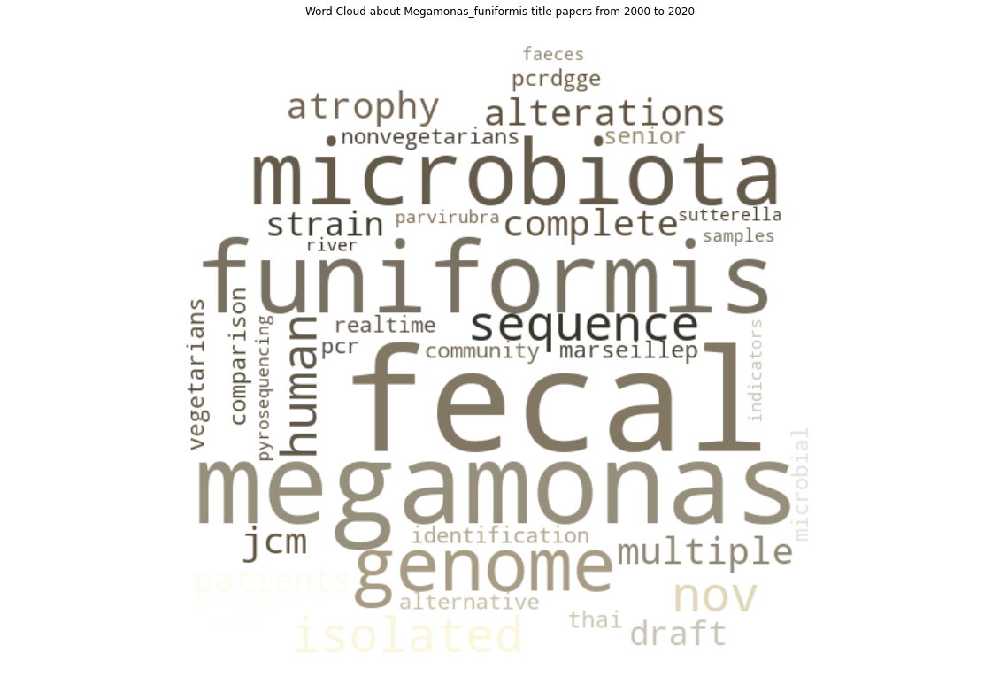

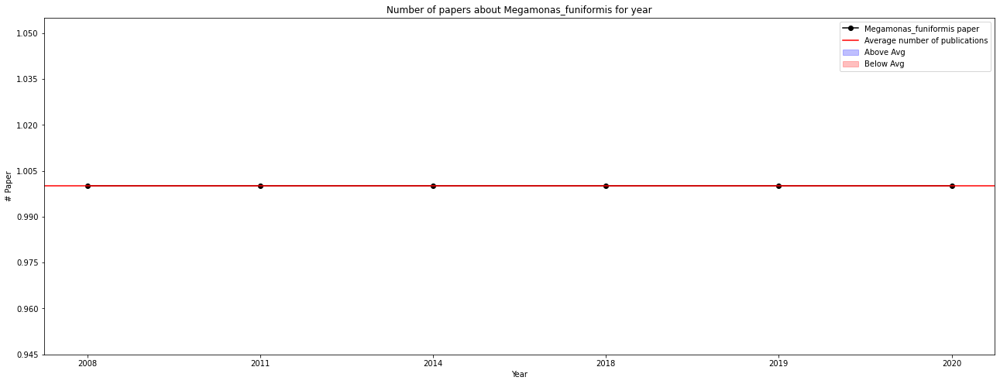

In [102]:


path_Megamonas = './images/Megamonas funiformis/'
query_Megamonas = 'Megamonas funiformis[All Fields]'
m_papers_Megamonas , m_dpt_Megamonas  = pipeline_analysis(path_Megamonas, 'Megamonas_funiformis', query_Megamonas)

In [103]:
m_papers_Megamonas

In [104]:
m_dpt_Megamonas

In [105]:
# organismo unico in not healthy young bifidobacterium longum[All Fields] 

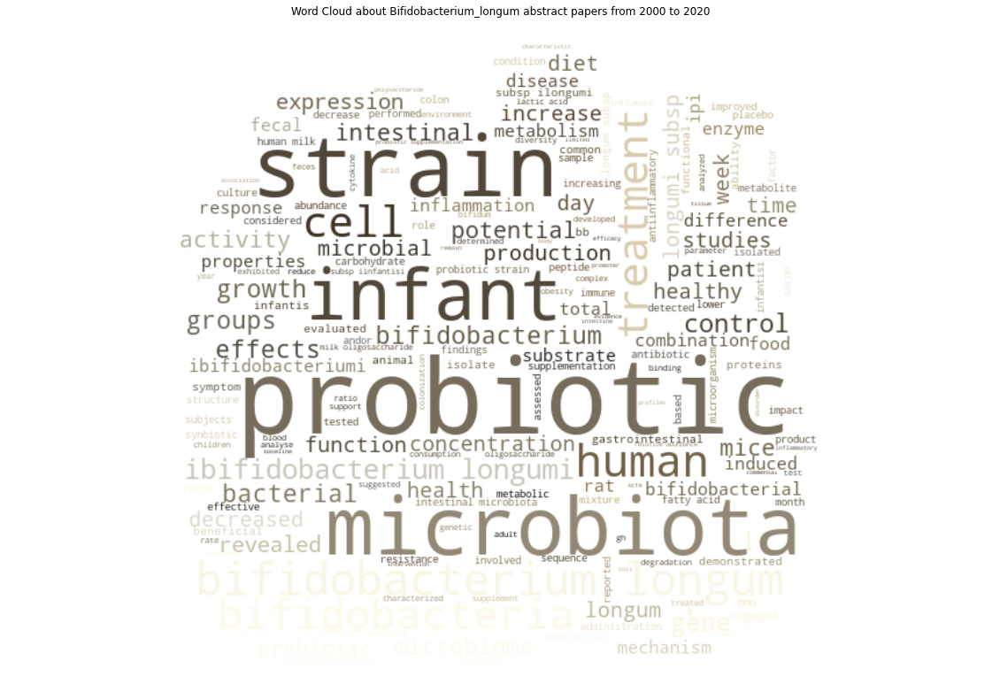

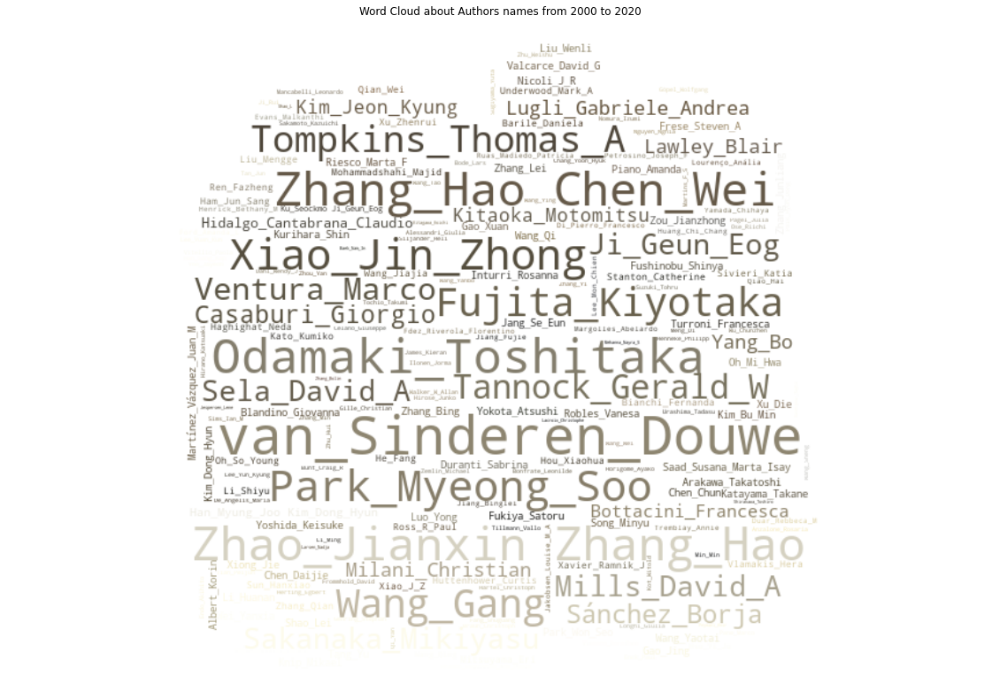

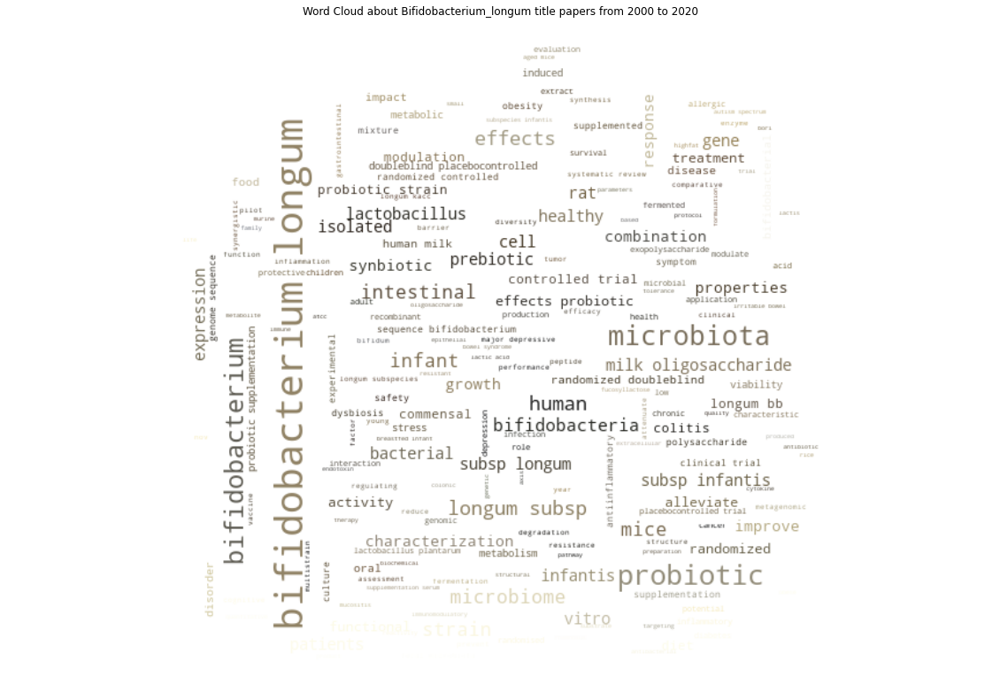

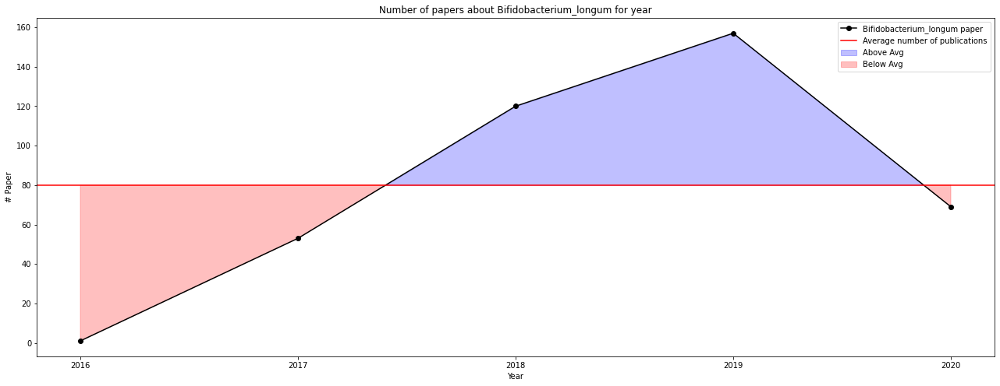

In [106]:

path_Bifidobacterium = './images/Bifidobacterium longum/'
query_Bifidobacterium = 'Bifidobacterium longum[All Fields]'
m_papers_Bifidobacterium , m_dpt_Bifidobacterium  = pipeline_analysis(path_Bifidobacterium, 'Bifidobacterium_longum', query_Bifidobacterium)

In [107]:
m_papers_Bifidobacterium

In [108]:
m_dpt_Bifidobacterium

In [109]:
#analisi cancer vs cardiovascular

In [18]:
cancer = "./data/final_blast_top_sequences_cancer.tsv"
cardiovascular = "./data/final_blast_top_sequences_cardiovascular.tsv"
top_cancer, top_cardiovascular , _, _, _ = load_data(cancer, cardiovascular)

In [19]:
top_organism(list(top_cancer['sciname'].values), list(top_cancer['accession'].values), "Top 10 organism cancer", "# accension", "organism", './images/') 

In [112]:
top_organism(list(top_cardiovascular['sciname'].values), list(top_cardiovascular['accession'].values), "Top 10 organism cardiovascular", "# accension", "organism", './images/') 

In [113]:
# organismi in comune cardiovascular vs cancer 

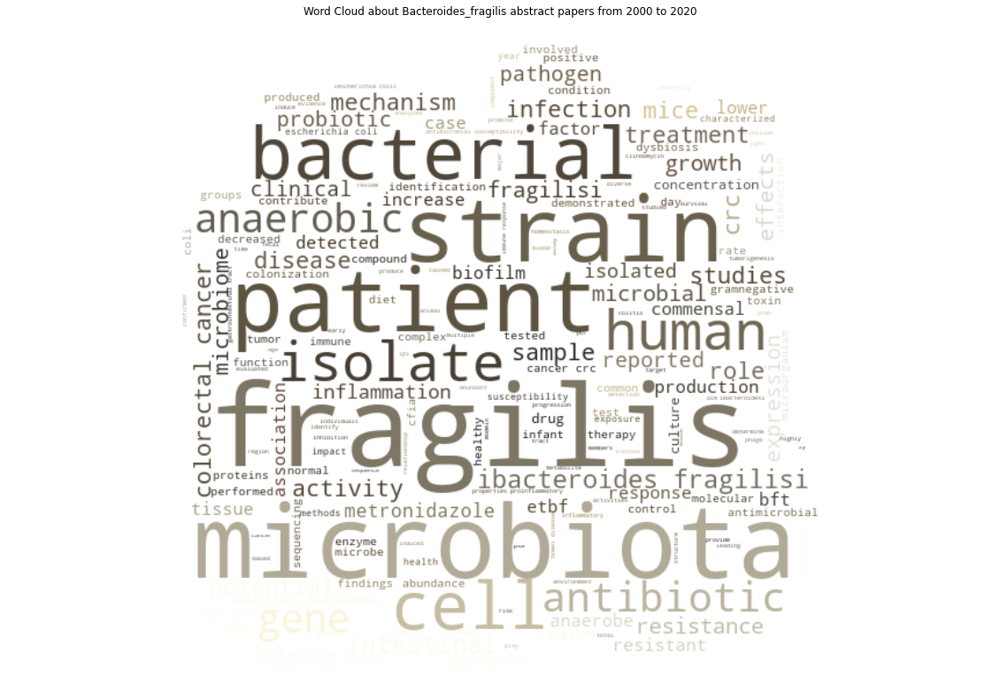

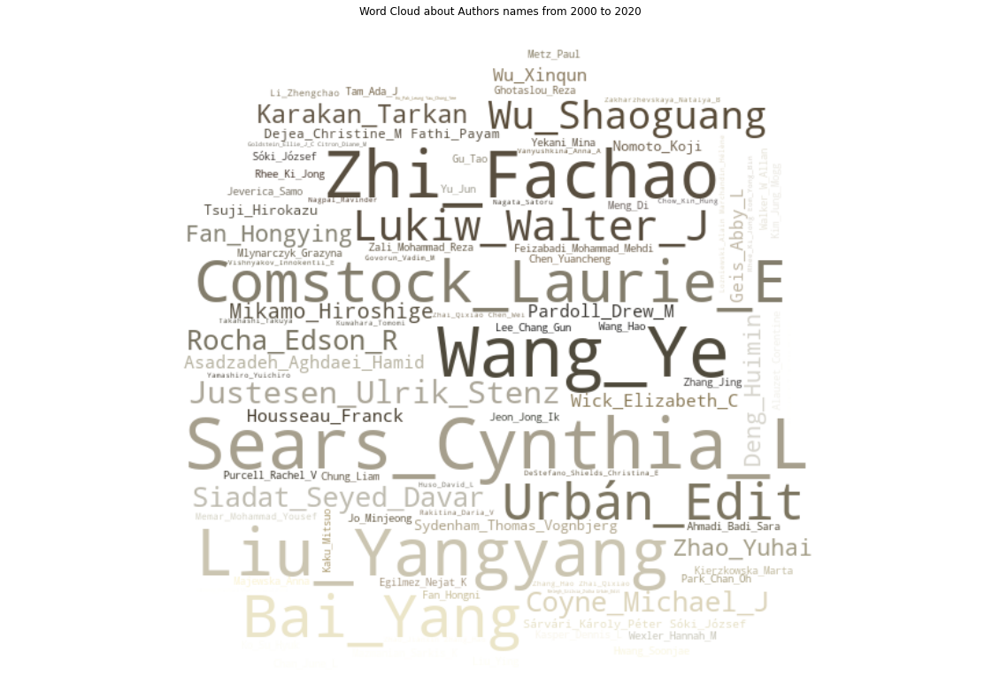

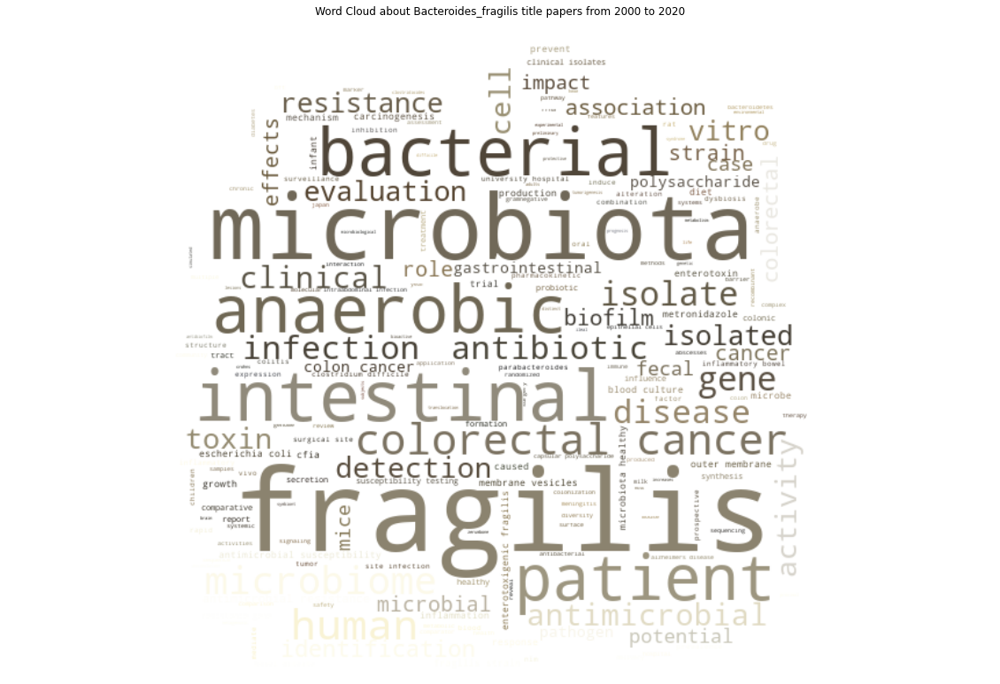

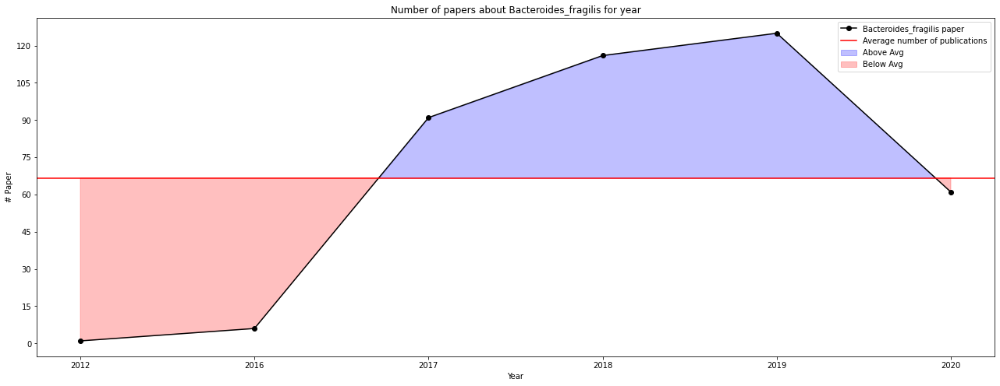

In [114]:
#Bacteroides fragilis
path_fragilis = './images/Bacteroides fragilis/'
query_fragilis = 'Bacteroides fragilis[All Fields]'
m_papers_fragilis , m_dpt_fragilis  = pipeline_analysis(path_fragilis, 'Bacteroides_fragilis', query_fragilis)

In [115]:
m_papers_fragilis

In [116]:
m_dpt_fragilis

In [117]:
#organismo solo in cardiovascular Proteus cibarius

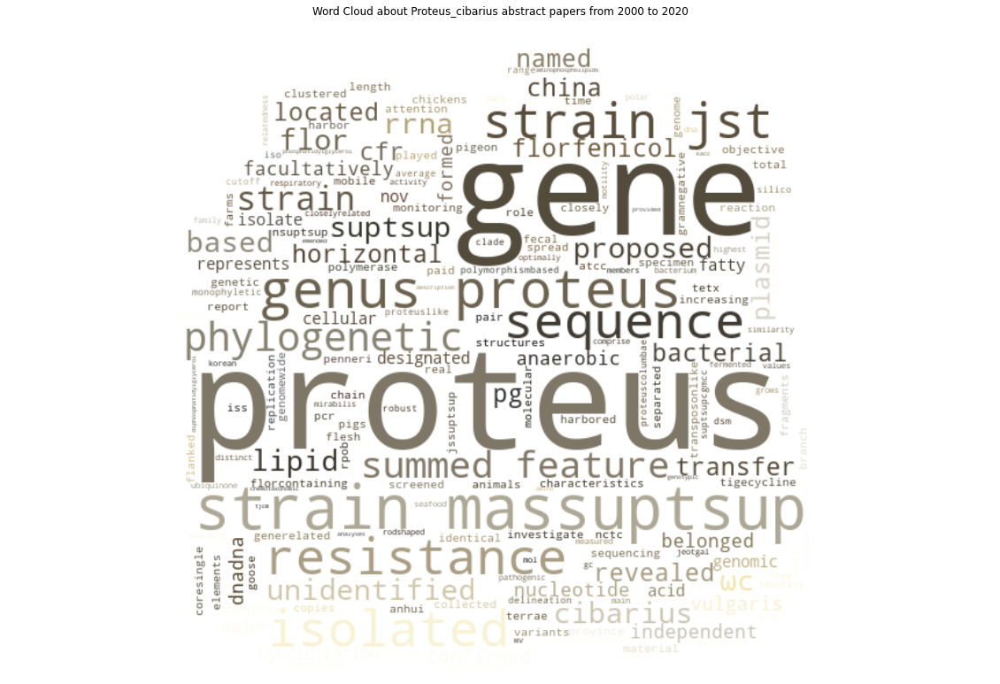

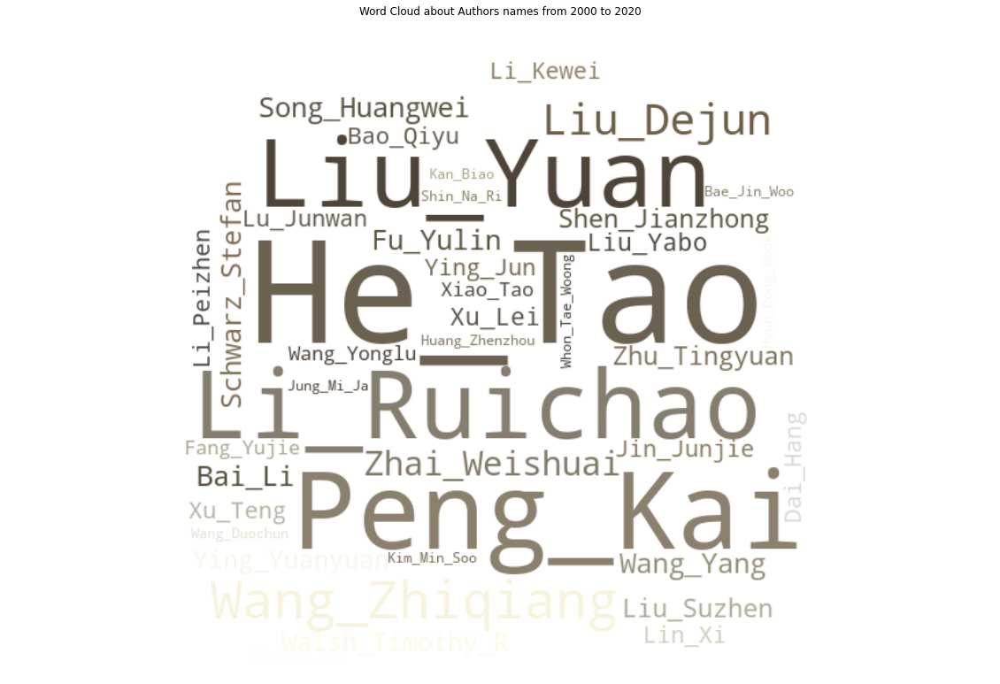

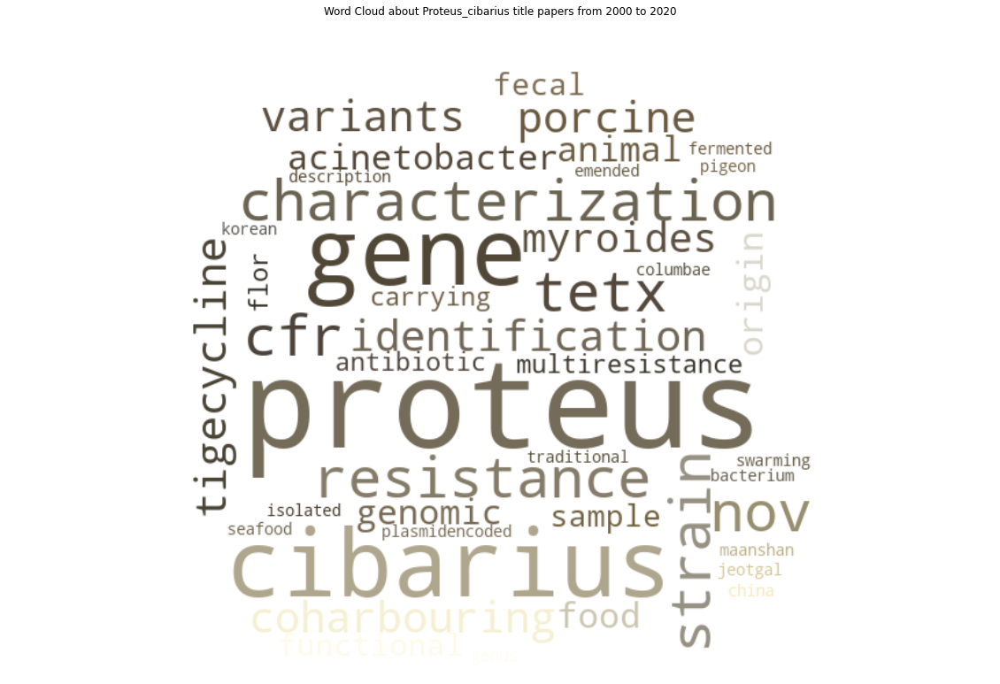

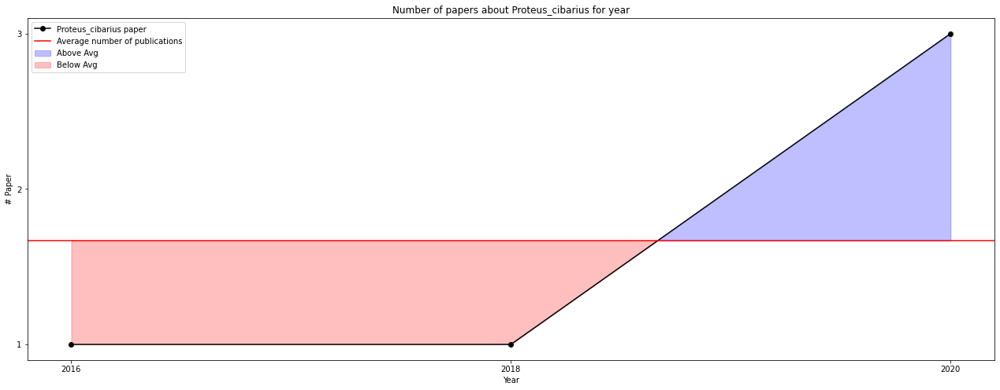

In [118]:
#Proteus cibarius
path_Proteus = './images/Proteus cibarius/'
query_Proteus = 'Proteus cibarius[All Fields]'
m_papers_Proteus , m_dpt_Proteus  = pipeline_analysis(path_Proteus, 'Proteus_cibarius', query_Proteus)

In [119]:
m_papers_Proteus

In [120]:
m_dpt_Proteus

In [3]:
#organismo solo in cancer Hafnia sp

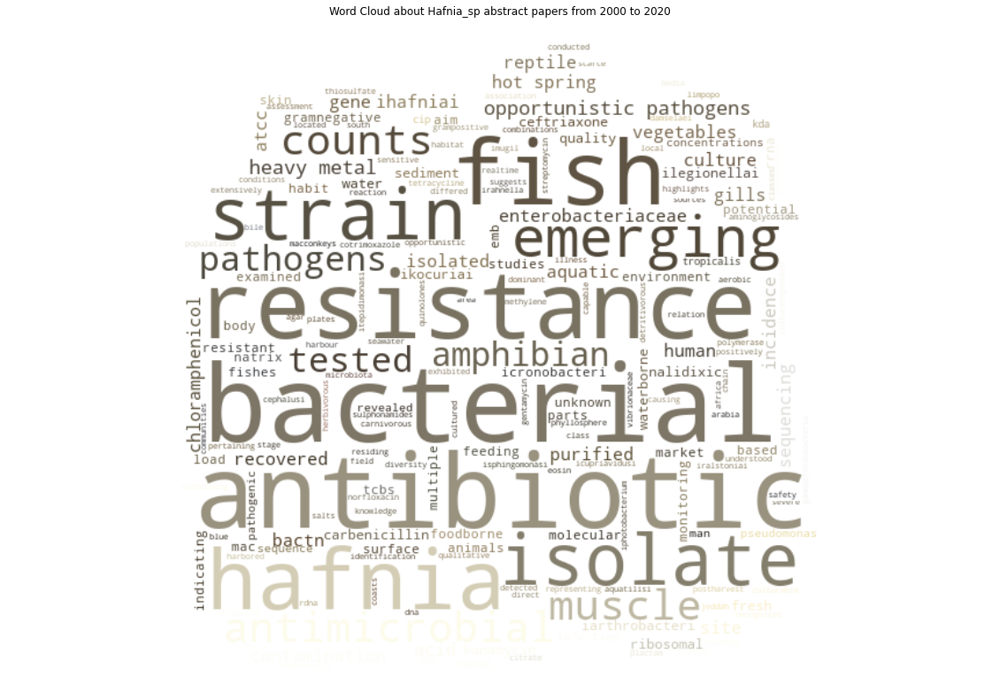

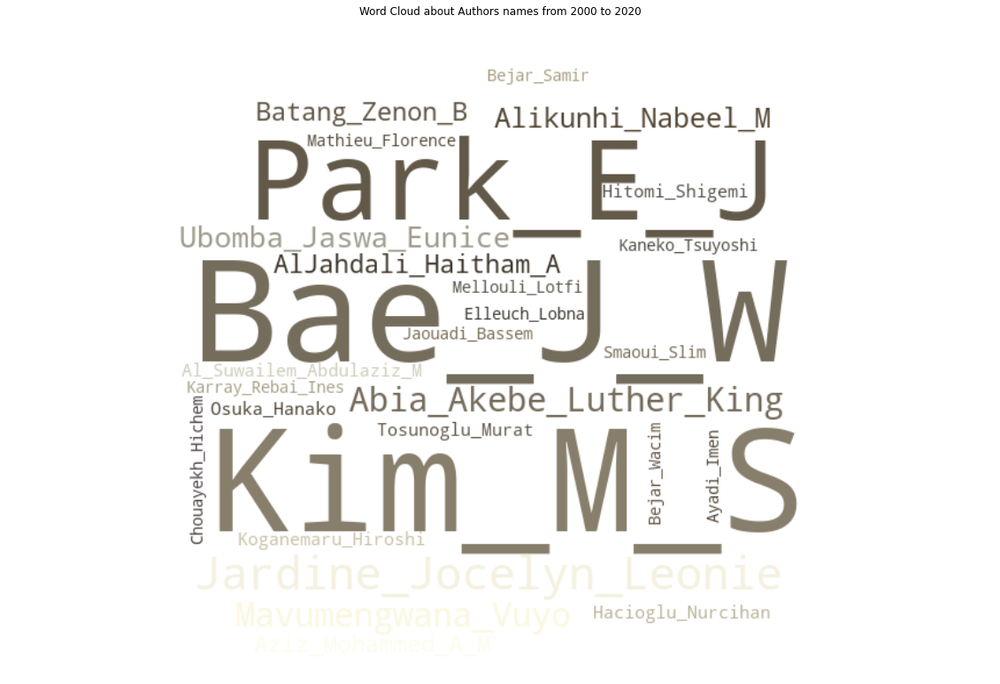

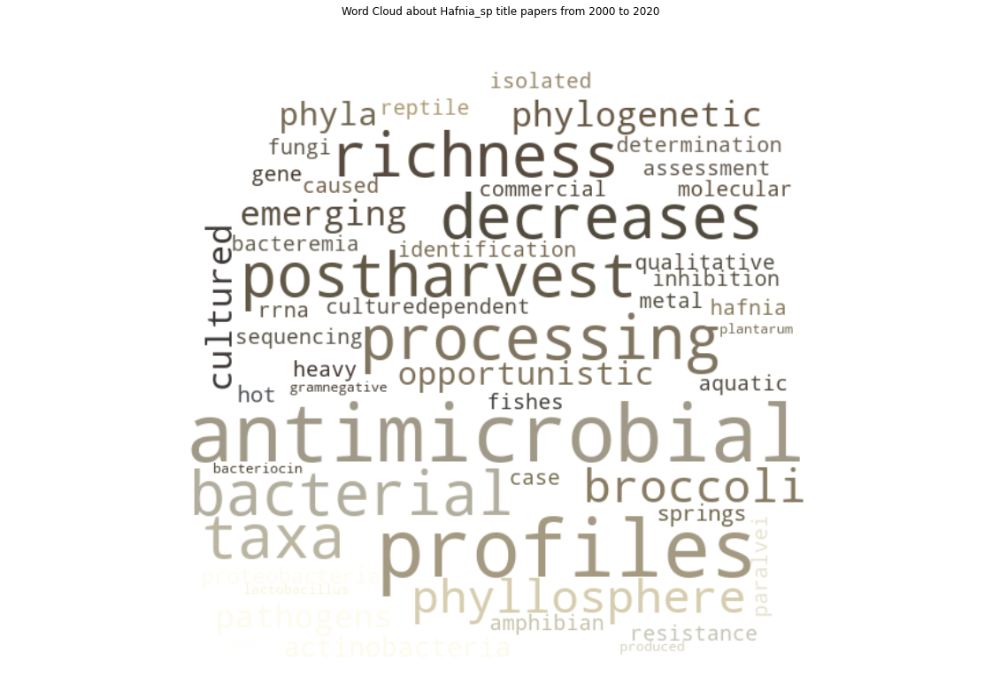

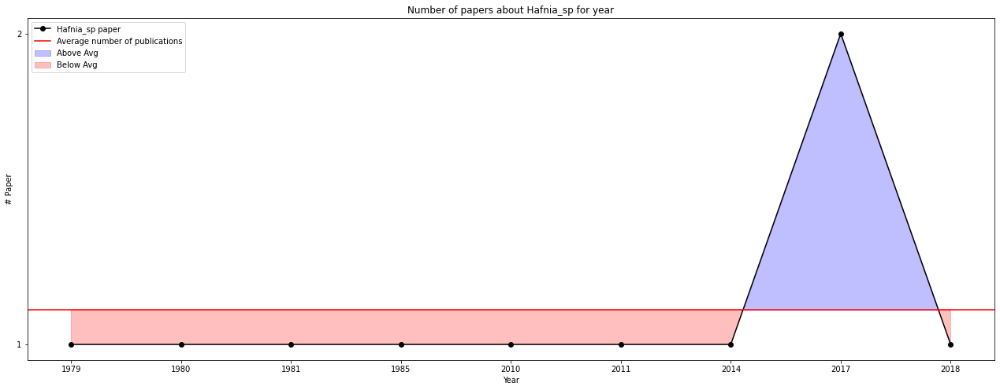

In [122]:
#Hafnia sp
path_Hafnia = './images/Hafnia sp/'
query_Hafnia = 'Hafnia sp[All Fields]'
m_papers_Hafnia , m_dpt_Hafnia  = pipeline_analysis(path_Hafnia, 'Hafnia_sp', query_Hafnia)

In [123]:
m_papers_Hafnia

In [124]:
m_dpt_Hafnia

In [1]:
#analisi healthy vs not healthy

In [12]:
healthy = "./data/final_blast_top_sequences_healthy2.tsv"
not_healthy = "./data/final_blast_top_sequences_not_healthy2.tsv"
top_healthy, top_not_healthy , _, _, _ = load_data(healthy, not_healthy)

In [20]:
top_organism(list(top_healthy['sciname'].values), list(top_healthy['accession'].values), "Top 10 organism healthy", "# accension", "organism", './images/') 

In [21]:
top_organism(list(top_not_healthy['sciname'].values), list(top_not_healthy['accession'].values), "Top 10 organism not healthy", "# accension", "organism", './images/') 

In [ ]:
#organismo presente solo in not healthy posizione 4 , raoultella ornithinolytica

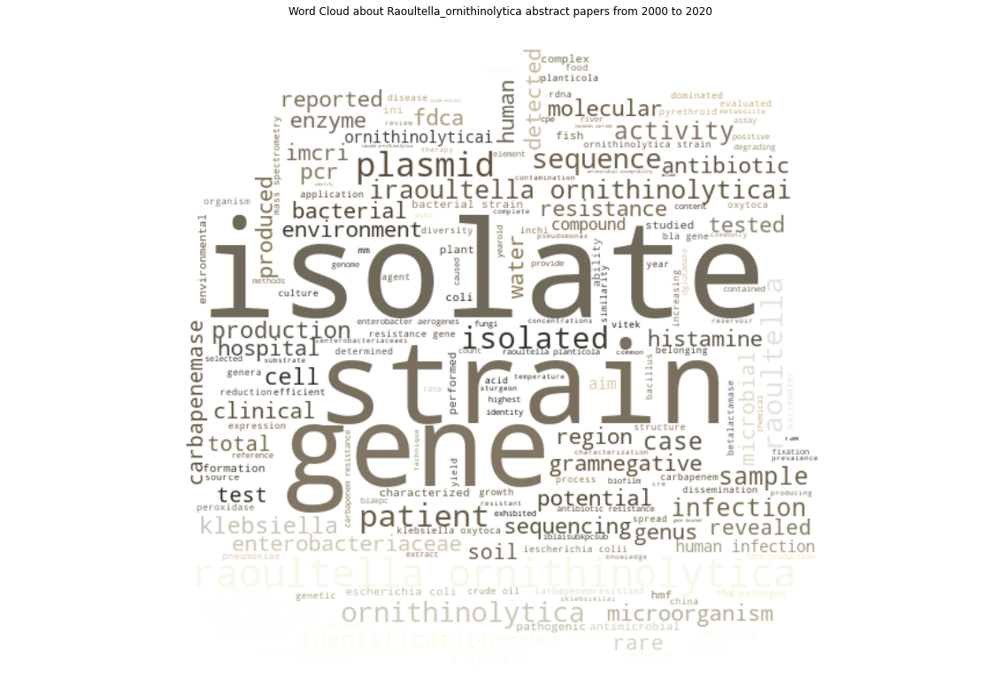

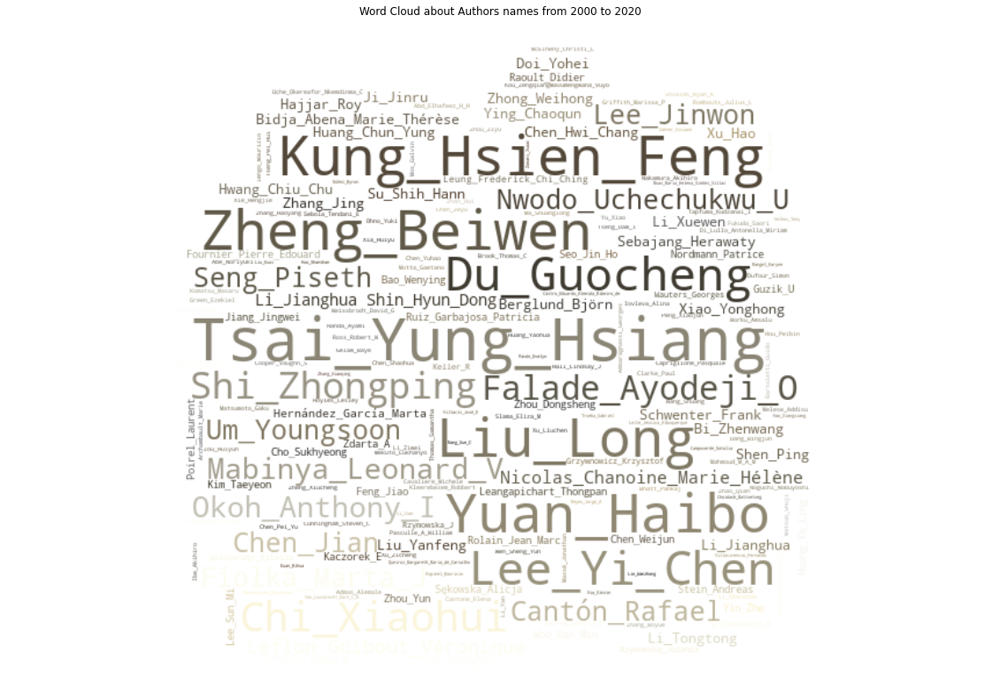

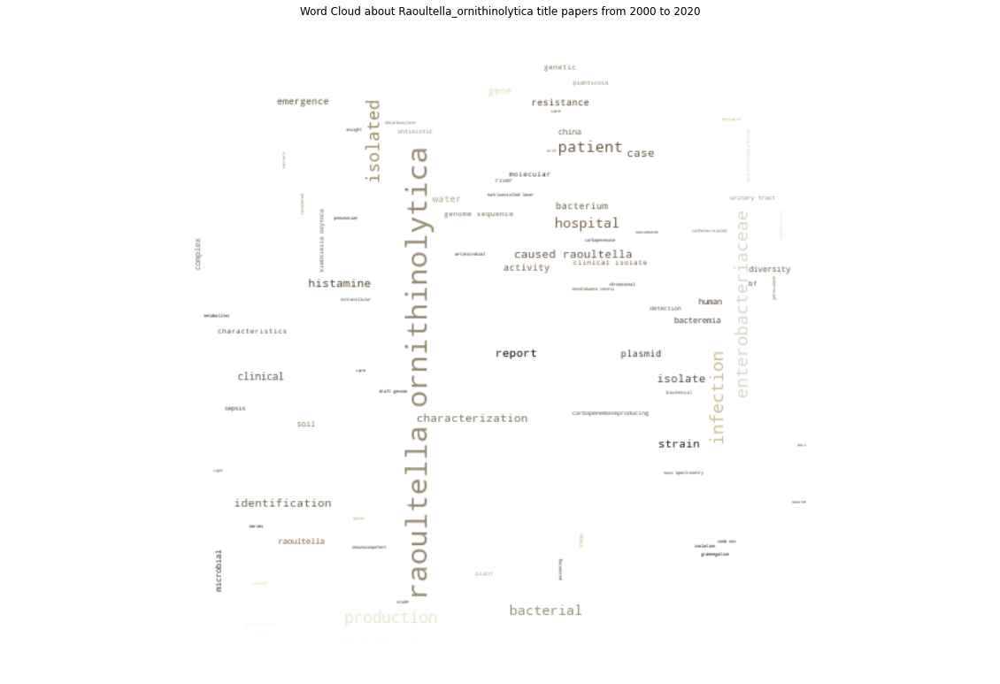

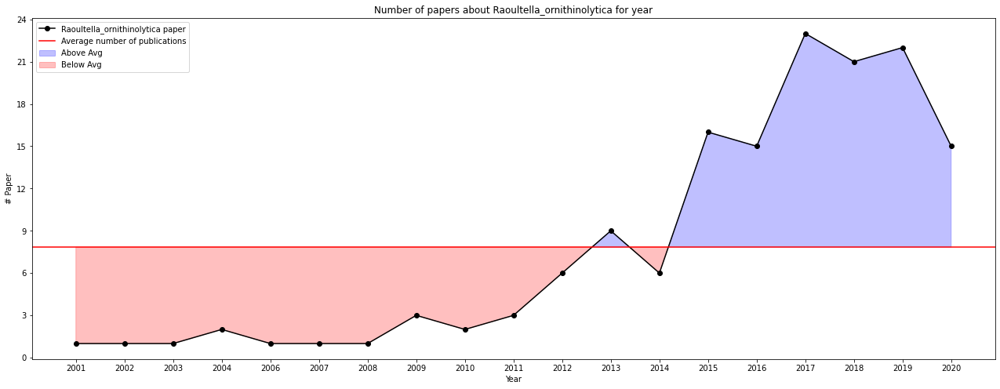

In [36]:
#Raoultella ornithinolytica
path_ornithinolytica = './images/Raoultella ornithinolytica/'
query_ornithinolytica = 'Raoultella ornithinolytica[All Fields]'
m_papers_ornithinolytica , m_ornithinolytica  = pipeline_analysis(path_ornithinolytica, 'Raoultella_ornithinolytica', query_ornithinolytica)

In [33]:
m_papers_ornithinolytica

In [34]:
m_ornithinolytica

In [ ]:
#organismo presente solo in healthy poszione 4, Acinetobacter sp

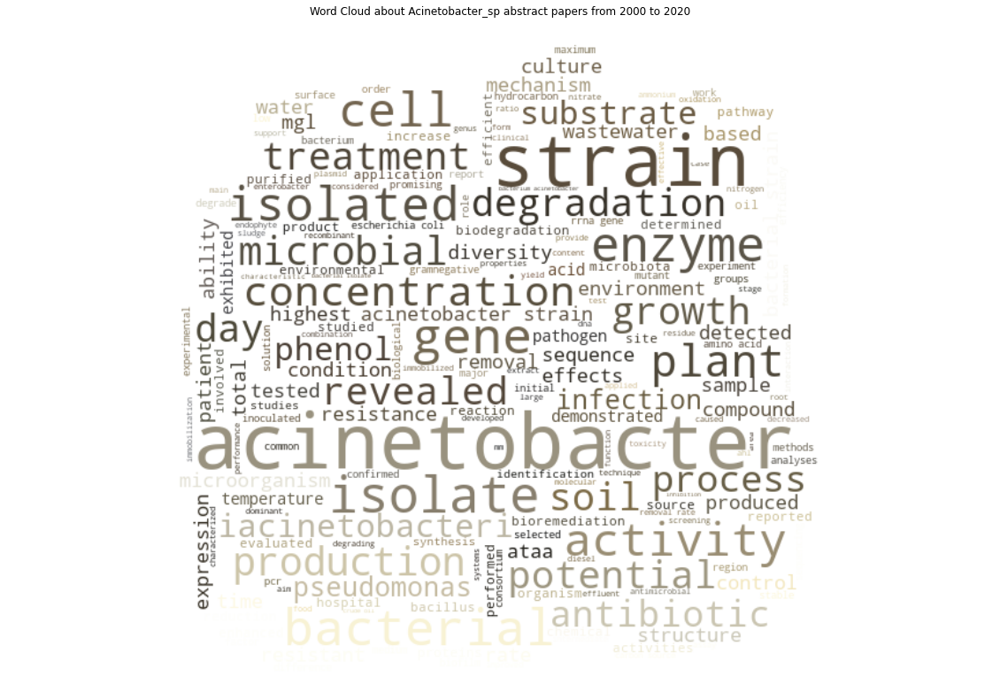

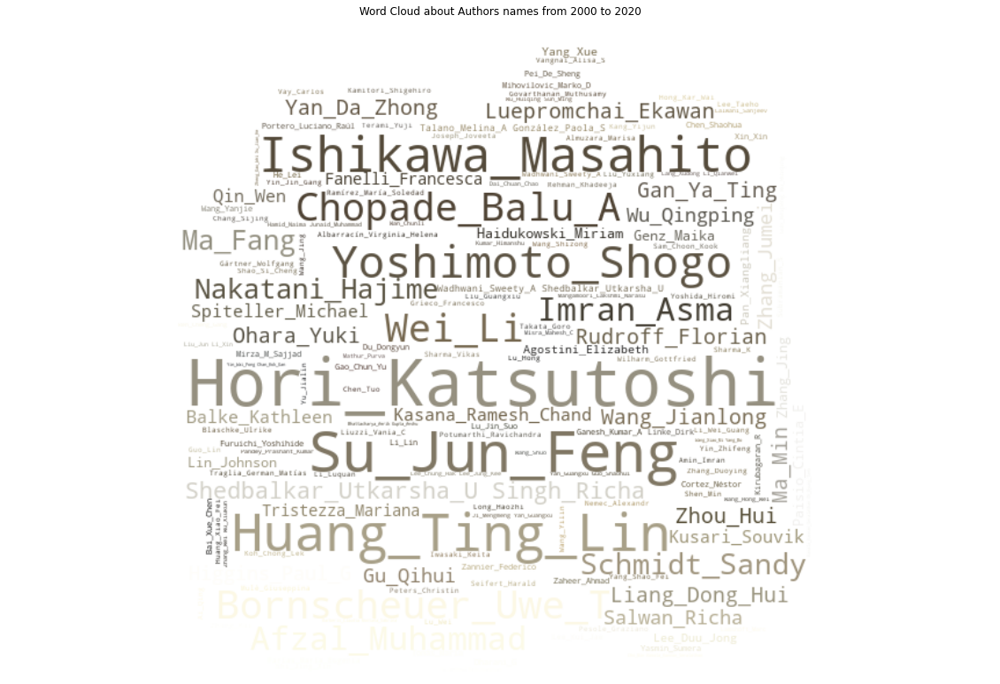

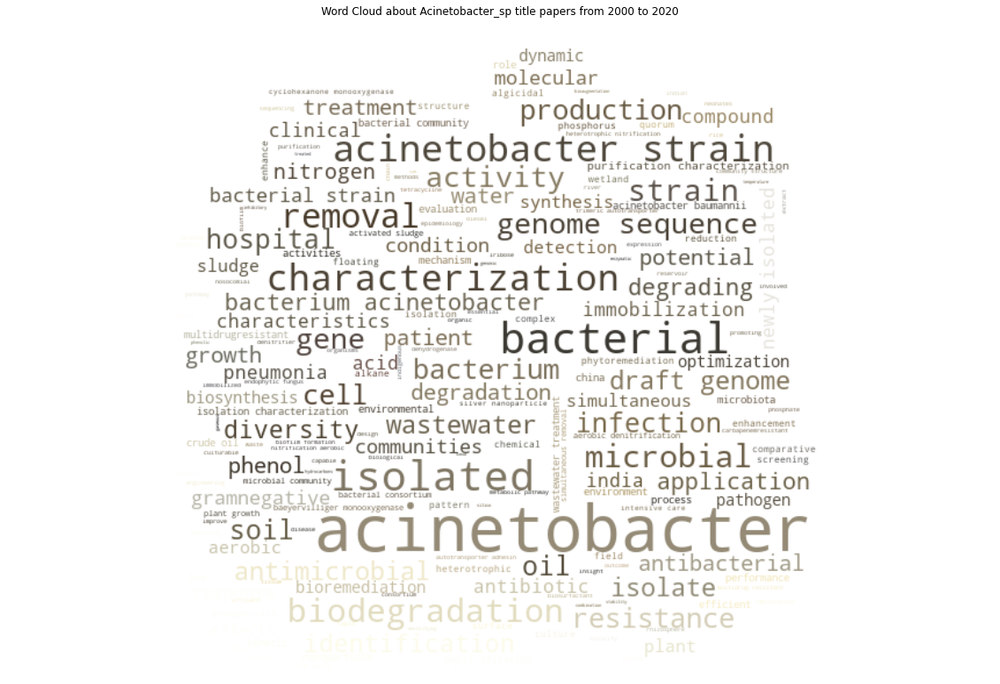

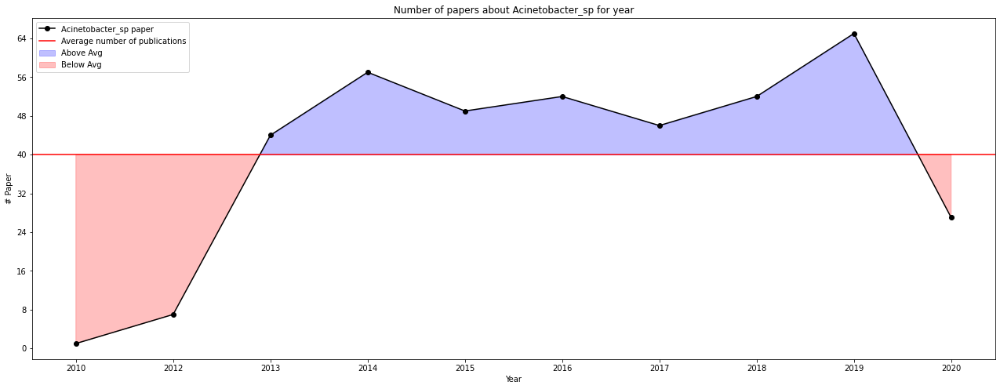

In [38]:
#Acinetobacter_sp
path_Acinetobacter_sp = './images/Acinetobacter sp/'
query_Acinetobacter_sp = 'Acinetobacter sp[All Fields]'
m_papers_Acinetobacter_sp , m_Acinetobacter_sp  = pipeline_analysis(path_Acinetobacter_sp, 'Acinetobacter_sp', query_Acinetobacter_sp)

In [39]:
m_papers_Acinetobacter_sp

In [40]:
m_Acinetobacter_sp